# Session (475165_f1_stage2_day3)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f1_stage2_day3" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f1"
day = "day3"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (34989, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


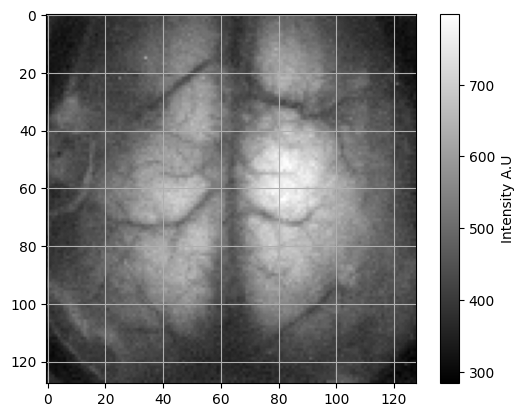

frame number 6000 plotted


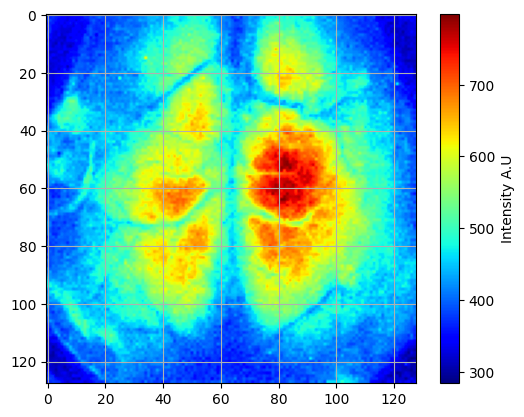

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 347.3783935546875 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 390.8006927490234


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 88
Number of double_flash pairs: 44
Number of single_flash: 41
Number of total flashes: 129


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/129 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/129 [00:01<02:58,  1.40s/it]

  2%|█▎                                                                                | 2/129 [00:02<02:53,  1.36s/it]

  2%|█▉                                                                                | 3/129 [00:04<02:55,  1.40s/it]

  3%|██▌                                                                               | 4/129 [00:05<02:53,  1.38s/it]

  4%|███▏                                                                              | 5/129 [00:06<02:49,  1.37s/it]

  5%|███▊                                                                              | 6/129 [00:08<02:48,  1.37s/it]

  5%|████▍                                                                             | 7/129 [00:09<02:47,  1.37s/it]

  6%|█████                                                                             | 8/129 [00:10<02:44,  1.36s/it]

  7%|█████▋                                                                            | 9/129 [00:12<02:41,  1.34s/it]

  8%|██████▎                                                                          | 10/129 [00:13<02:39,  1.34s/it]

  9%|██████▉                                                                          | 11/129 [00:14<02:39,  1.35s/it]

  9%|███████▌                                                                         | 12/129 [00:16<02:41,  1.38s/it]

 10%|████████▏                                                                        | 13/129 [00:17<02:39,  1.38s/it]

 11%|████████▊                                                                        | 14/129 [00:19<02:38,  1.38s/it]

 12%|█████████▍                                                                       | 15/129 [00:20<02:40,  1.41s/it]

 12%|██████████                                                                       | 16/129 [00:21<02:36,  1.38s/it]

 13%|██████████▋                                                                      | 17/129 [00:23<02:33,  1.37s/it]

 14%|███████████▎                                                                     | 18/129 [00:24<02:35,  1.40s/it]

 15%|███████████▉                                                                     | 19/129 [00:26<02:29,  1.36s/it]

 16%|████████████▌                                                                    | 20/129 [00:27<02:29,  1.37s/it]

 16%|█████████████▏                                                                   | 21/129 [00:28<02:26,  1.35s/it]

 17%|█████████████▊                                                                   | 22/129 [00:30<02:24,  1.35s/it]

 18%|██████████████▍                                                                  | 23/129 [00:31<02:20,  1.32s/it]

 19%|███████████████                                                                  | 24/129 [00:32<02:21,  1.35s/it]

 19%|███████████████▋                                                                 | 25/129 [00:34<02:21,  1.36s/it]

 20%|████████████████▎                                                                | 26/129 [00:35<02:19,  1.36s/it]

 21%|████████████████▉                                                                | 27/129 [00:36<02:18,  1.36s/it]

 22%|█████████████████▌                                                               | 28/129 [00:38<02:17,  1.37s/it]

 22%|██████████████████▏                                                              | 29/129 [00:39<02:15,  1.36s/it]

 23%|██████████████████▊                                                              | 30/129 [00:40<02:14,  1.36s/it]

 24%|███████████████████▍                                                             | 31/129 [00:42<02:17,  1.40s/it]

 25%|████████████████████                                                             | 32/129 [00:43<02:15,  1.40s/it]

 26%|████████████████████▋                                                            | 33/129 [00:45<02:13,  1.39s/it]

 26%|█████████████████████▎                                                           | 34/129 [00:46<02:11,  1.39s/it]

 27%|█████████████████████▉                                                           | 35/129 [00:47<02:09,  1.38s/it]

 28%|██████████████████████▌                                                          | 36/129 [00:49<02:05,  1.35s/it]

 29%|███████████████████████▏                                                         | 37/129 [00:50<02:03,  1.34s/it]

 29%|███████████████████████▊                                                         | 38/129 [00:51<02:01,  1.33s/it]

 30%|████████████████████████▍                                                        | 39/129 [00:53<02:00,  1.34s/it]

 31%|█████████████████████████                                                        | 40/129 [00:54<01:59,  1.34s/it]

 32%|█████████████████████████▋                                                       | 41/129 [00:55<01:58,  1.34s/it]

 33%|██████████████████████████▎                                                      | 42/129 [00:57<01:56,  1.34s/it]

 33%|███████████████████████████                                                      | 43/129 [00:58<01:55,  1.34s/it]

 34%|███████████████████████████▋                                                     | 44/129 [00:59<01:53,  1.33s/it]

 35%|████████████████████████████▎                                                    | 45/129 [01:01<01:50,  1.32s/it]

 36%|████████████████████████████▉                                                    | 46/129 [01:02<01:53,  1.37s/it]

 36%|█████████████████████████████▌                                                   | 47/129 [01:04<01:51,  1.36s/it]

 37%|██████████████████████████████▏                                                  | 48/129 [01:05<01:49,  1.35s/it]

 38%|██████████████████████████████▊                                                  | 49/129 [01:06<01:47,  1.35s/it]

 39%|███████████████████████████████▍                                                 | 50/129 [01:08<01:48,  1.37s/it]

 40%|████████████████████████████████                                                 | 51/129 [01:09<01:46,  1.36s/it]

 40%|████████████████████████████████▋                                                | 52/129 [01:10<01:47,  1.39s/it]

 41%|█████████████████████████████████▎                                               | 53/129 [01:12<01:44,  1.37s/it]

 42%|█████████████████████████████████▉                                               | 54/129 [01:13<01:41,  1.36s/it]

 43%|██████████████████████████████████▌                                              | 55/129 [01:14<01:40,  1.36s/it]

 43%|███████████████████████████████████▏                                             | 56/129 [01:16<01:37,  1.33s/it]

 44%|███████████████████████████████████▊                                             | 57/129 [01:17<01:34,  1.31s/it]

 45%|████████████████████████████████████▍                                            | 58/129 [01:18<01:34,  1.32s/it]

 46%|█████████████████████████████████████                                            | 59/129 [01:20<01:33,  1.34s/it]

 47%|█████████████████████████████████████▋                                           | 60/129 [01:21<01:30,  1.32s/it]

 47%|██████████████████████████████████████▎                                          | 61/129 [01:22<01:30,  1.34s/it]

 48%|██████████████████████████████████████▉                                          | 62/129 [01:24<01:30,  1.35s/it]

 49%|███████████████████████████████████████▌                                         | 63/129 [01:25<01:31,  1.39s/it]

 50%|████████████████████████████████████████▏                                        | 64/129 [01:26<01:27,  1.35s/it]

 50%|████████████████████████████████████████▊                                        | 65/129 [01:28<01:26,  1.35s/it]

 51%|█████████████████████████████████████████▍                                       | 66/129 [01:29<01:23,  1.32s/it]

 52%|██████████████████████████████████████████                                       | 67/129 [01:30<01:22,  1.33s/it]

 53%|██████████████████████████████████████████▋                                      | 68/129 [01:32<01:21,  1.33s/it]

 53%|███████████████████████████████████████████▎                                     | 69/129 [01:33<01:20,  1.35s/it]

 54%|███████████████████████████████████████████▉                                     | 70/129 [01:34<01:18,  1.34s/it]

 55%|████████████████████████████████████████████▌                                    | 71/129 [01:36<01:17,  1.34s/it]

 56%|█████████████████████████████████████████████▏                                   | 72/129 [01:37<01:17,  1.37s/it]

 57%|█████████████████████████████████████████████▊                                   | 73/129 [01:39<01:15,  1.36s/it]

 57%|██████████████████████████████████████████████▍                                  | 74/129 [01:40<01:15,  1.37s/it]

 58%|███████████████████████████████████████████████                                  | 75/129 [01:41<01:13,  1.36s/it]

 59%|███████████████████████████████████████████████▋                                 | 76/129 [01:43<01:10,  1.33s/it]

 60%|████████████████████████████████████████████████▎                                | 77/129 [01:44<01:08,  1.32s/it]

 60%|████████████████████████████████████████████████▉                                | 78/129 [01:45<01:06,  1.30s/it]

 61%|█████████████████████████████████████████████████▌                               | 79/129 [01:46<01:06,  1.32s/it]

 62%|██████████████████████████████████████████████████▏                              | 80/129 [01:48<01:05,  1.34s/it]

 63%|██████████████████████████████████████████████████▊                              | 81/129 [01:49<01:02,  1.31s/it]

 64%|███████████████████████████████████████████████████▍                             | 82/129 [01:51<01:03,  1.35s/it]

 64%|████████████████████████████████████████████████████                             | 83/129 [01:52<01:01,  1.34s/it]

 65%|████████████████████████████████████████████████████▋                            | 84/129 [01:53<00:59,  1.31s/it]

 66%|█████████████████████████████████████████████████████▎                           | 85/129 [01:55<00:59,  1.36s/it]

 67%|██████████████████████████████████████████████████████                           | 86/129 [01:56<00:58,  1.36s/it]

 67%|██████████████████████████████████████████████████████▋                          | 87/129 [01:57<00:56,  1.35s/it]

 68%|███████████████████████████████████████████████████████▎                         | 88/129 [01:59<00:54,  1.33s/it]

 69%|███████████████████████████████████████████████████████▉                         | 89/129 [02:00<00:54,  1.36s/it]

 70%|████████████████████████████████████████████████████████▌                        | 90/129 [02:01<00:53,  1.37s/it]

 71%|█████████████████████████████████████████████████████████▏                       | 91/129 [02:03<00:52,  1.39s/it]

 71%|█████████████████████████████████████████████████████████▊                       | 92/129 [02:04<00:50,  1.37s/it]

 72%|██████████████████████████████████████████████████████████▍                      | 93/129 [02:05<00:48,  1.35s/it]

 73%|███████████████████████████████████████████████████████████                      | 94/129 [02:07<00:47,  1.35s/it]

 74%|███████████████████████████████████████████████████████████▋                     | 95/129 [02:08<00:47,  1.38s/it]

 74%|████████████████████████████████████████████████████████████▎                    | 96/129 [02:09<00:43,  1.33s/it]

 75%|████████████████████████████████████████████████████████████▉                    | 97/129 [02:11<00:43,  1.35s/it]

 76%|█████████████████████████████████████████████████████████████▌                   | 98/129 [02:12<00:42,  1.37s/it]

 77%|██████████████████████████████████████████████████████████████▏                  | 99/129 [02:14<00:40,  1.36s/it]

 78%|██████████████████████████████████████████████████████████████                  | 100/129 [02:15<00:39,  1.35s/it]

 78%|██████████████████████████████████████████████████████████████▋                 | 101/129 [02:16<00:38,  1.37s/it]

 79%|███████████████████████████████████████████████████████████████▎                | 102/129 [02:18<00:36,  1.36s/it]

 80%|███████████████████████████████████████████████████████████████▉                | 103/129 [02:19<00:35,  1.35s/it]

 81%|████████████████████████████████████████████████████████████████▍               | 104/129 [02:20<00:33,  1.36s/it]

 81%|█████████████████████████████████████████████████████████████████               | 105/129 [02:22<00:32,  1.35s/it]

 82%|█████████████████████████████████████████████████████████████████▋              | 106/129 [02:23<00:30,  1.34s/it]

 83%|██████████████████████████████████████████████████████████████████▎             | 107/129 [02:24<00:29,  1.32s/it]

 84%|██████████████████████████████████████████████████████████████████▉             | 108/129 [02:26<00:27,  1.33s/it]

 84%|███████████████████████████████████████████████████████████████████▌            | 109/129 [02:27<00:26,  1.30s/it]

 85%|████████████████████████████████████████████████████████████████████▏           | 110/129 [02:28<00:25,  1.32s/it]

 86%|████████████████████████████████████████████████████████████████████▊           | 111/129 [02:30<00:24,  1.35s/it]

 87%|█████████████████████████████████████████████████████████████████████▍          | 112/129 [02:31<00:22,  1.34s/it]

 88%|██████████████████████████████████████████████████████████████████████          | 113/129 [02:32<00:21,  1.35s/it]

 88%|██████████████████████████████████████████████████████████████████████▋         | 114/129 [02:34<00:20,  1.35s/it]

 89%|███████████████████████████████████████████████████████████████████████▎        | 115/129 [02:35<00:18,  1.36s/it]

 90%|███████████████████████████████████████████████████████████████████████▉        | 116/129 [02:36<00:17,  1.36s/it]

 91%|████████████████████████████████████████████████████████████████████████▌       | 117/129 [02:38<00:16,  1.36s/it]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 118/129 [02:39<00:15,  1.36s/it]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 119/129 [02:41<00:13,  1.36s/it]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 120/129 [02:42<00:12,  1.36s/it]

 94%|███████████████████████████████████████████████████████████████████████████     | 121/129 [02:43<00:11,  1.38s/it]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 122/129 [02:45<00:09,  1.34s/it]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 123/129 [02:46<00:08,  1.35s/it]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 124/129 [02:47<00:06,  1.35s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 125/129 [02:49<00:05,  1.32s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 126/129 [02:50<00:03,  1.32s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 127/129 [02:51<00:02,  1.33s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 128/129 [02:53<00:01,  1.34s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 129/129 [02:54<00:00,  1.36s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 129/129 [02:54<00:00,  1.35s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 22%|█████████████████▌                                                              | 28/128 [00:00<00:00, 277.32it/s]

 44%|███████████████████████████████████                                             | 56/128 [00:00<00:00, 267.96it/s]

 65%|███████████████████████████████████████████████████▉                            | 83/128 [00:00<00:00, 264.20it/s]

 86%|███████████████████████████████████████████████████████████████████▉           | 110/128 [00:00<00:00, 259.48it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 245.29it/s]

  0%|                                                                                        | 0/34473 [00:00<?, ?it/s]

  0%|                                                                              | 29/34473 [00:00<02:02, 281.64it/s]

  0%|▏                                                                             | 58/34473 [00:00<02:07, 269.34it/s]

  0%|▏                                                                             | 86/34473 [00:00<02:07, 270.50it/s]

  0%|▎                                                                            | 114/34473 [00:00<02:22, 241.84it/s]

  0%|▎                                                                            | 141/34473 [00:00<02:17, 250.20it/s]

  0%|▍                                                                            | 169/34473 [00:00<02:13, 256.41it/s]

  1%|▍                                                                            | 195/34473 [00:00<02:16, 251.34it/s]

  1%|▌                                                                            | 224/34473 [00:00<02:11, 261.43it/s]

  1%|▌                                                                            | 251/34473 [00:00<02:11, 259.36it/s]

  1%|▌                                                                            | 278/34473 [00:01<02:14, 254.26it/s]

  1%|▋                                                                            | 304/34473 [00:01<02:20, 243.24it/s]

  1%|▋                                                                            | 329/34473 [00:01<02:26, 232.67it/s]

  1%|▊                                                                            | 353/34473 [00:01<02:28, 230.26it/s]

  1%|▊                                                                            | 380/34473 [00:01<02:21, 240.11it/s]

  1%|▉                                                                            | 405/34473 [00:01<02:21, 240.21it/s]

  1%|▉                                                                            | 430/34473 [00:01<02:21, 240.29it/s]

  1%|█                                                                            | 455/34473 [00:01<02:20, 242.41it/s]

  1%|█                                                                            | 482/34473 [00:01<02:18, 245.47it/s]

  1%|█▏                                                                           | 510/34473 [00:02<02:14, 252.71it/s]

  2%|█▏                                                                           | 537/34473 [00:02<02:12, 257.01it/s]

  2%|█▎                                                                           | 564/34473 [00:02<02:10, 260.37it/s]

  2%|█▎                                                                           | 592/34473 [00:02<02:08, 263.85it/s]

  2%|█▍                                                                           | 620/34473 [00:02<02:06, 267.84it/s]

  2%|█▍                                                                           | 648/34473 [00:02<02:05, 269.86it/s]

  2%|█▌                                                                           | 676/34473 [00:02<02:05, 269.70it/s]

  2%|█▌                                                                           | 703/34473 [00:02<02:10, 258.40it/s]

  2%|█▋                                                                           | 730/34473 [00:02<02:09, 260.26it/s]

  2%|█▋                                                                           | 757/34473 [00:02<02:13, 252.15it/s]

  2%|█▋                                                                           | 783/34473 [00:03<02:13, 252.26it/s]

  2%|█▊                                                                           | 811/34473 [00:03<02:10, 257.29it/s]

  2%|█▊                                                                           | 838/34473 [00:03<02:10, 257.27it/s]

  3%|█▉                                                                           | 864/34473 [00:03<02:12, 254.41it/s]

  3%|█▉                                                                           | 892/34473 [00:03<02:08, 260.33it/s]

  3%|██                                                                           | 919/34473 [00:03<02:15, 247.33it/s]

  3%|██                                                                           | 946/34473 [00:03<02:12, 252.31it/s]

  3%|██▏                                                                          | 974/34473 [00:03<02:09, 258.76it/s]

  3%|██▏                                                                         | 1000/34473 [00:03<02:15, 247.71it/s]

  3%|██▎                                                                         | 1029/34473 [00:04<02:09, 257.51it/s]

  3%|██▎                                                                         | 1055/34473 [00:04<02:17, 243.23it/s]

  3%|██▍                                                                         | 1080/34473 [00:04<02:21, 235.96it/s]

  3%|██▍                                                                         | 1104/34473 [00:04<02:23, 231.97it/s]

  3%|██▍                                                                         | 1131/34473 [00:04<02:17, 241.80it/s]

  3%|██▌                                                                         | 1157/34473 [00:04<02:16, 244.85it/s]

  3%|██▌                                                                         | 1183/34473 [00:04<02:15, 246.14it/s]

  4%|██▋                                                                         | 1210/34473 [00:04<02:11, 252.31it/s]

  4%|██▋                                                                         | 1236/34473 [00:04<02:15, 244.61it/s]

  4%|██▊                                                                         | 1263/34473 [00:05<02:12, 249.74it/s]

  4%|██▊                                                                         | 1291/34473 [00:05<02:09, 257.00it/s]

  4%|██▉                                                                         | 1317/34473 [00:05<02:10, 254.21it/s]

  4%|██▉                                                                         | 1344/34473 [00:05<02:09, 256.58it/s]

  4%|███                                                                         | 1373/34473 [00:05<02:05, 264.04it/s]

  4%|███                                                                         | 1400/34473 [00:05<02:05, 263.50it/s]

  4%|███▏                                                                        | 1429/34473 [00:05<02:02, 268.92it/s]

  4%|███▏                                                                        | 1458/34473 [00:05<02:01, 271.94it/s]

  4%|███▎                                                                        | 1486/34473 [00:05<02:09, 254.24it/s]

  4%|███▎                                                                        | 1512/34473 [00:05<02:14, 244.28it/s]

  4%|███▍                                                                        | 1541/34473 [00:06<02:09, 254.80it/s]

  5%|███▍                                                                        | 1567/34473 [00:06<02:10, 252.04it/s]

  5%|███▌                                                                        | 1596/34473 [00:06<02:05, 261.33it/s]

  5%|███▌                                                                        | 1625/34473 [00:06<02:02, 268.42it/s]

  5%|███▋                                                                        | 1652/34473 [00:06<02:05, 260.60it/s]

  5%|███▋                                                                        | 1679/34473 [00:06<02:05, 260.33it/s]

  5%|███▊                                                                        | 1706/34473 [00:06<02:15, 242.22it/s]

  5%|███▊                                                                        | 1731/34473 [00:06<02:19, 235.33it/s]

  5%|███▊                                                                        | 1755/34473 [00:06<02:22, 229.71it/s]

  5%|███▉                                                                        | 1782/34473 [00:07<02:16, 240.17it/s]

  5%|███▉                                                                        | 1808/34473 [00:07<02:14, 243.04it/s]

  5%|████                                                                        | 1835/34473 [00:07<02:11, 248.62it/s]

  5%|████                                                                        | 1862/34473 [00:07<02:08, 252.97it/s]

  5%|████▏                                                                       | 1888/34473 [00:07<02:12, 245.63it/s]

  6%|████▏                                                                       | 1917/34473 [00:07<02:07, 256.11it/s]

  6%|████▎                                                                       | 1946/34473 [00:07<02:03, 264.36it/s]

  6%|████▎                                                                       | 1973/34473 [00:07<02:05, 258.56it/s]

  6%|████▍                                                                       | 1999/34473 [00:07<02:06, 257.34it/s]

  6%|████▍                                                                       | 2028/34473 [00:08<02:02, 264.53it/s]

  6%|████▌                                                                       | 2055/34473 [00:08<02:03, 262.33it/s]

  6%|████▌                                                                       | 2082/34473 [00:08<02:05, 257.84it/s]

  6%|████▋                                                                       | 2110/34473 [00:08<02:03, 262.74it/s]

  6%|████▋                                                                       | 2138/34473 [00:08<02:01, 267.00it/s]

  6%|████▊                                                                       | 2166/34473 [00:08<01:59, 269.64it/s]

  6%|████▊                                                                       | 2194/34473 [00:08<01:59, 271.12it/s]

  6%|████▉                                                                       | 2222/34473 [00:08<01:58, 272.96it/s]

  7%|████▉                                                                       | 2250/34473 [00:08<02:11, 244.70it/s]

  7%|█████                                                                       | 2279/34473 [00:08<02:05, 256.39it/s]

  7%|█████                                                                       | 2306/34473 [00:09<02:07, 252.42it/s]

  7%|█████▏                                                                      | 2332/34473 [00:09<02:14, 239.84it/s]

  7%|█████▏                                                                      | 2357/34473 [00:09<02:15, 237.13it/s]

  7%|█████▎                                                                      | 2386/34473 [00:09<02:08, 249.69it/s]

  7%|█████▎                                                                      | 2414/34473 [00:09<02:04, 256.80it/s]

  7%|█████▍                                                                      | 2442/34473 [00:09<02:01, 262.70it/s]

  7%|█████▍                                                                      | 2470/34473 [00:09<02:00, 266.19it/s]

  7%|█████▌                                                                      | 2497/34473 [00:09<02:01, 263.11it/s]

  7%|█████▌                                                                      | 2526/34473 [00:09<01:58, 269.38it/s]

  7%|█████▋                                                                      | 2555/34473 [00:10<01:56, 273.04it/s]

  7%|█████▋                                                                      | 2583/34473 [00:10<01:57, 271.14it/s]

  8%|█████▊                                                                      | 2611/34473 [00:10<01:59, 266.75it/s]

  8%|█████▊                                                                      | 2640/34473 [00:10<01:57, 270.37it/s]

  8%|█████▉                                                                      | 2668/34473 [00:10<01:56, 272.64it/s]

  8%|█████▉                                                                      | 2696/34473 [00:10<01:56, 273.76it/s]

  8%|██████                                                                      | 2724/34473 [00:10<01:55, 274.01it/s]

  8%|██████                                                                      | 2752/34473 [00:10<02:01, 261.62it/s]

  8%|██████▏                                                                     | 2779/34473 [00:10<02:06, 250.47it/s]

  8%|██████▏                                                                     | 2806/34473 [00:11<02:04, 255.23it/s]

  8%|██████▏                                                                     | 2832/34473 [00:11<02:06, 249.52it/s]

  8%|██████▎                                                                     | 2860/34473 [00:11<02:03, 256.00it/s]

  8%|██████▎                                                                     | 2888/34473 [00:11<02:01, 260.66it/s]

  8%|██████▍                                                                     | 2917/34473 [00:11<01:58, 266.84it/s]

  9%|██████▍                                                                     | 2944/34473 [00:11<02:01, 259.50it/s]

  9%|██████▌                                                                     | 2971/34473 [00:11<02:05, 251.72it/s]

  9%|██████▌                                                                     | 2997/34473 [00:11<02:05, 251.18it/s]

  9%|██████▋                                                                     | 3024/34473 [00:11<02:03, 255.18it/s]

  9%|██████▋                                                                     | 3050/34473 [00:11<02:04, 251.87it/s]

  9%|██████▊                                                                     | 3078/34473 [00:12<02:01, 257.39it/s]

  9%|██████▊                                                                     | 3106/34473 [00:12<01:59, 261.69it/s]

  9%|██████▉                                                                     | 3134/34473 [00:12<01:58, 265.49it/s]

  9%|██████▉                                                                     | 3161/34473 [00:12<02:02, 255.64it/s]

  9%|███████                                                                     | 3187/34473 [00:12<02:17, 227.07it/s]

  9%|███████                                                                     | 3211/34473 [00:12<02:17, 227.50it/s]

  9%|███████▏                                                                    | 3240/34473 [00:12<02:09, 241.90it/s]

  9%|███████▏                                                                    | 3266/34473 [00:12<02:06, 246.60it/s]

 10%|███████▎                                                                    | 3292/34473 [00:12<02:05, 249.02it/s]

 10%|███████▎                                                                    | 3318/34473 [00:13<02:16, 228.56it/s]

 10%|███████▎                                                                    | 3342/34473 [00:13<02:19, 223.21it/s]

 10%|███████▍                                                                    | 3368/34473 [00:13<02:14, 231.97it/s]

 10%|███████▍                                                                    | 3392/34473 [00:13<02:20, 221.87it/s]

 10%|███████▌                                                                    | 3420/34473 [00:13<02:10, 237.17it/s]

 10%|███████▌                                                                    | 3447/34473 [00:13<02:07, 243.67it/s]

 10%|███████▋                                                                    | 3472/34473 [00:13<02:09, 240.28it/s]

 10%|███████▋                                                                    | 3499/34473 [00:13<02:05, 245.95it/s]

 10%|███████▊                                                                    | 3524/34473 [00:13<02:08, 240.58it/s]

 10%|███████▊                                                                    | 3552/34473 [00:14<02:03, 249.70it/s]

 10%|███████▉                                                                    | 3578/34473 [00:14<02:02, 252.42it/s]

 10%|███████▉                                                                    | 3604/34473 [00:14<02:04, 248.51it/s]

 11%|████████                                                                    | 3631/34473 [00:14<02:01, 253.25it/s]

 11%|████████                                                                    | 3657/34473 [00:14<02:04, 246.63it/s]

 11%|████████                                                                    | 3683/34473 [00:14<02:03, 249.77it/s]

 11%|████████▏                                                                   | 3709/34473 [00:14<02:03, 249.86it/s]

 11%|████████▏                                                                   | 3736/34473 [00:14<02:01, 253.53it/s]

 11%|████████▎                                                                   | 3763/34473 [00:14<01:59, 257.60it/s]

 11%|████████▎                                                                   | 3790/34473 [00:14<01:58, 258.99it/s]

 11%|████████▍                                                                   | 3818/34473 [00:15<01:56, 262.10it/s]

 11%|████████▍                                                                   | 3845/34473 [00:15<01:57, 260.63it/s]

 11%|████████▌                                                                   | 3873/34473 [00:15<01:55, 264.00it/s]

 11%|████████▌                                                                   | 3900/34473 [00:15<02:04, 245.66it/s]

 11%|████████▋                                                                   | 3927/34473 [00:15<02:01, 251.07it/s]

 11%|████████▋                                                                   | 3954/34473 [00:15<01:59, 255.02it/s]

 12%|████████▊                                                                   | 3982/34473 [00:15<01:57, 259.98it/s]

 12%|████████▊                                                                   | 4009/34473 [00:15<01:59, 254.09it/s]

 12%|████████▉                                                                   | 4037/34473 [00:15<01:57, 259.29it/s]

 12%|████████▉                                                                   | 4064/34473 [00:16<01:57, 259.77it/s]

 12%|█████████                                                                   | 4092/34473 [00:16<01:55, 264.12it/s]

 12%|█████████                                                                   | 4119/34473 [00:16<01:55, 263.56it/s]

 12%|█████████▏                                                                  | 4146/34473 [00:16<02:04, 244.08it/s]

 12%|█████████▏                                                                  | 4174/34473 [00:16<02:00, 251.30it/s]

 12%|█████████▎                                                                  | 4201/34473 [00:16<01:58, 255.87it/s]

 12%|█████████▎                                                                  | 4227/34473 [00:16<02:06, 238.63it/s]

 12%|█████████▎                                                                  | 4252/34473 [00:16<02:08, 234.68it/s]

 12%|█████████▍                                                                  | 4279/34473 [00:16<02:03, 243.79it/s]

 12%|█████████▍                                                                  | 4304/34473 [00:17<02:10, 231.56it/s]

 13%|█████████▌                                                                  | 4332/34473 [00:17<02:03, 243.56it/s]

 13%|█████████▌                                                                  | 4360/34473 [00:17<01:59, 251.72it/s]

 13%|█████████▋                                                                  | 4386/34473 [00:17<02:03, 243.02it/s]

 13%|█████████▋                                                                  | 4414/34473 [00:17<01:59, 252.00it/s]

 13%|█████████▊                                                                  | 4443/34473 [00:17<01:54, 261.36it/s]

 13%|█████████▊                                                                  | 4470/34473 [00:17<01:56, 257.93it/s]

 13%|█████████▉                                                                  | 4497/34473 [00:17<01:54, 260.67it/s]

 13%|█████████▉                                                                  | 4524/34473 [00:17<01:54, 261.13it/s]

 13%|██████████                                                                  | 4551/34473 [00:17<01:56, 256.28it/s]

 13%|██████████                                                                  | 4580/34473 [00:18<01:52, 265.25it/s]

 13%|██████████▏                                                                 | 4607/34473 [00:18<01:58, 252.00it/s]

 13%|██████████▏                                                                 | 4634/34473 [00:18<01:56, 255.66it/s]

 14%|██████████▎                                                                 | 4660/34473 [00:18<01:59, 250.48it/s]

 14%|██████████▎                                                                 | 4686/34473 [00:18<02:04, 240.22it/s]

 14%|██████████▍                                                                 | 4713/34473 [00:18<02:00, 247.16it/s]

 14%|██████████▍                                                                 | 4742/34473 [00:18<01:55, 257.87it/s]

 14%|██████████▌                                                                 | 4771/34473 [00:18<01:51, 266.36it/s]

 14%|██████████▌                                                                 | 4798/34473 [00:18<01:53, 261.37it/s]

 14%|██████████▋                                                                 | 4825/34473 [00:19<01:52, 262.37it/s]

 14%|██████████▋                                                                 | 4852/34473 [00:19<01:54, 258.60it/s]

 14%|██████████▊                                                                 | 4878/34473 [00:19<01:55, 256.81it/s]

 14%|██████████▊                                                                 | 4904/34473 [00:19<01:56, 254.07it/s]

 14%|██████████▉                                                                 | 4933/34473 [00:19<01:51, 263.79it/s]

 14%|██████████▉                                                                 | 4960/34473 [00:19<02:00, 245.30it/s]

 14%|██████████▉                                                                 | 4985/34473 [00:19<01:59, 246.49it/s]

 15%|███████████                                                                 | 5012/34473 [00:19<01:57, 251.06it/s]

 15%|███████████                                                                 | 5038/34473 [00:19<02:04, 236.03it/s]

 15%|███████████▏                                                                | 5062/34473 [00:20<02:06, 232.65it/s]

 15%|███████████▏                                                                | 5086/34473 [00:20<02:05, 234.07it/s]

 15%|███████████▎                                                                | 5115/34473 [00:20<01:57, 249.30it/s]

 15%|███████████▎                                                                | 5141/34473 [00:20<01:59, 244.65it/s]

 15%|███████████▍                                                                | 5169/34473 [00:20<01:56, 251.89it/s]

 15%|███████████▍                                                                | 5196/34473 [00:20<01:54, 254.92it/s]

 15%|███████████▌                                                                | 5222/34473 [00:20<01:56, 252.04it/s]

 15%|███████████▌                                                                | 5249/34473 [00:20<01:54, 255.78it/s]

 15%|███████████▋                                                                | 5275/34473 [00:20<01:55, 253.35it/s]

 15%|███████████▋                                                                | 5302/34473 [00:20<01:53, 255.98it/s]

 15%|███████████▋                                                                | 5329/34473 [00:21<01:53, 257.84it/s]

 16%|███████████▊                                                                | 5355/34473 [00:21<01:56, 249.74it/s]

 16%|███████████▊                                                                | 5381/34473 [00:21<01:58, 244.97it/s]

 16%|███████████▉                                                                | 5409/34473 [00:21<01:54, 253.53it/s]

 16%|███████████▉                                                                | 5435/34473 [00:21<01:54, 252.51it/s]

 16%|████████████                                                                | 5462/34473 [00:21<01:53, 256.11it/s]

 16%|████████████                                                                | 5488/34473 [00:21<01:53, 255.04it/s]

 16%|████████████▏                                                               | 5517/34473 [00:21<01:50, 262.21it/s]

 16%|████████████▏                                                               | 5546/34473 [00:21<01:47, 268.00it/s]

 16%|████████████▎                                                               | 5575/34473 [00:22<01:45, 272.87it/s]

 16%|████████████▎                                                               | 5603/34473 [00:22<01:50, 260.47it/s]

 16%|████████████▍                                                               | 5632/34473 [00:22<01:48, 265.87it/s]

 16%|████████████▍                                                               | 5660/34473 [00:22<01:47, 269.17it/s]

 17%|████████████▌                                                               | 5689/34473 [00:22<01:45, 272.86it/s]

 17%|████████████▌                                                               | 5717/34473 [00:22<01:49, 262.76it/s]

 17%|████████████▋                                                               | 5744/34473 [00:22<02:01, 237.20it/s]

 17%|████████████▋                                                               | 5770/34473 [00:22<01:58, 242.07it/s]

 17%|████████████▊                                                               | 5796/34473 [00:22<01:56, 245.21it/s]

 17%|████████████▊                                                               | 5822/34473 [00:23<01:55, 248.68it/s]

 17%|████████████▉                                                               | 5848/34473 [00:23<01:55, 247.00it/s]

 17%|████████████▉                                                               | 5873/34473 [00:23<01:57, 244.39it/s]

 17%|█████████████                                                               | 5900/34473 [00:23<01:54, 249.62it/s]

 17%|█████████████                                                               | 5928/34473 [00:23<01:51, 256.20it/s]

 17%|█████████████▏                                                              | 5955/34473 [00:23<01:50, 257.99it/s]

 17%|█████████████▏                                                              | 5982/34473 [00:23<01:49, 259.25it/s]

 17%|█████████████▏                                                              | 6008/34473 [00:23<01:53, 250.70it/s]

 18%|█████████████▎                                                              | 6034/34473 [00:23<01:53, 251.24it/s]

 18%|█████████████▎                                                              | 6061/34473 [00:23<01:51, 254.48it/s]

 18%|█████████████▍                                                              | 6090/34473 [00:24<01:47, 264.06it/s]

 18%|█████████████▍                                                              | 6117/34473 [00:24<01:47, 263.51it/s]

 18%|█████████████▌                                                              | 6145/34473 [00:24<01:46, 266.81it/s]

 18%|█████████████▌                                                              | 6172/34473 [00:24<01:50, 255.03it/s]

 18%|█████████████▋                                                              | 6198/34473 [00:24<01:53, 249.35it/s]

 18%|█████████████▋                                                              | 6226/34473 [00:24<01:49, 257.71it/s]

 18%|█████████████▊                                                              | 6252/34473 [00:24<01:52, 249.76it/s]

 18%|█████████████▊                                                              | 6280/34473 [00:24<01:49, 256.93it/s]

 18%|█████████████▉                                                              | 6306/34473 [00:24<01:49, 256.36it/s]

 18%|█████████████▉                                                              | 6332/34473 [00:25<01:52, 249.48it/s]

 18%|██████████████                                                              | 6360/34473 [00:25<01:49, 256.78it/s]

 19%|██████████████                                                              | 6386/34473 [00:25<01:57, 239.06it/s]

 19%|██████████████▏                                                             | 6411/34473 [00:25<02:01, 231.22it/s]

 19%|██████████████▏                                                             | 6436/34473 [00:25<01:58, 235.75it/s]

 19%|██████████████▏                                                             | 6460/34473 [00:25<01:59, 234.99it/s]

 19%|██████████████▎                                                             | 6484/34473 [00:25<02:00, 232.47it/s]

 19%|██████████████▎                                                             | 6514/34473 [00:25<01:52, 249.19it/s]

 19%|██████████████▍                                                             | 6543/34473 [00:25<01:47, 260.30it/s]

 19%|██████████████▍                                                             | 6570/34473 [00:25<01:50, 253.56it/s]

 19%|██████████████▌                                                             | 6596/34473 [00:26<01:54, 243.59it/s]

 19%|██████████████▌                                                             | 6622/34473 [00:26<01:52, 247.52it/s]

 19%|██████████████▋                                                             | 6651/34473 [00:26<01:47, 258.20it/s]

 19%|██████████████▋                                                             | 6677/34473 [00:26<01:52, 247.33it/s]

 19%|██████████████▊                                                             | 6702/34473 [00:26<01:54, 241.95it/s]

 20%|██████████████▊                                                             | 6727/34473 [00:26<02:01, 228.74it/s]

 20%|██████████████▉                                                             | 6751/34473 [00:26<02:01, 228.72it/s]

 20%|██████████████▉                                                             | 6778/34473 [00:26<01:56, 237.60it/s]

 20%|██████████████▉                                                             | 6802/34473 [00:26<01:57, 234.98it/s]

 20%|███████████████                                                             | 6829/34473 [00:27<01:53, 244.28it/s]

 20%|███████████████                                                             | 6854/34473 [00:27<01:54, 241.09it/s]

 20%|███████████████▏                                                            | 6883/34473 [00:27<01:49, 253.01it/s]

 20%|███████████████▏                                                            | 6909/34473 [00:27<01:53, 243.76it/s]

 20%|███████████████▎                                                            | 6937/34473 [00:27<01:49, 251.92it/s]

 20%|███████████████▎                                                            | 6964/34473 [00:27<01:47, 255.66it/s]

 20%|███████████████▍                                                            | 6990/34473 [00:27<01:48, 254.00it/s]

 20%|███████████████▍                                                            | 7016/34473 [00:27<01:49, 251.39it/s]

 20%|███████████████▌                                                            | 7042/34473 [00:27<01:52, 243.35it/s]

 21%|███████████████▌                                                            | 7067/34473 [00:28<01:53, 240.48it/s]

 21%|███████████████▋                                                            | 7094/34473 [00:28<01:50, 246.80it/s]

 21%|███████████████▋                                                            | 7121/34473 [00:28<01:48, 252.04it/s]

 21%|███████████████▊                                                            | 7147/34473 [00:28<01:50, 246.51it/s]

 21%|███████████████▊                                                            | 7176/34473 [00:28<01:46, 256.79it/s]

 21%|███████████████▉                                                            | 7203/34473 [00:28<01:44, 259.82it/s]

 21%|███████████████▉                                                            | 7230/34473 [00:28<01:53, 240.90it/s]

 21%|███████████████▉                                                            | 7257/34473 [00:28<01:49, 247.59it/s]

 21%|████████████████                                                            | 7283/34473 [00:28<01:48, 251.01it/s]

 21%|████████████████                                                            | 7310/34473 [00:28<01:46, 254.29it/s]

 21%|████████████████▏                                                           | 7338/34473 [00:29<01:44, 260.24it/s]

 21%|████████████████▏                                                           | 7365/34473 [00:29<01:44, 258.59it/s]

 21%|████████████████▎                                                           | 7391/34473 [00:29<01:44, 258.28it/s]

 22%|████████████████▎                                                           | 7417/34473 [00:29<01:45, 257.30it/s]

 22%|████████████████▍                                                           | 7443/34473 [00:29<01:45, 255.87it/s]

 22%|████████████████▍                                                           | 7471/34473 [00:29<01:42, 262.21it/s]

 22%|████████████████▌                                                           | 7500/34473 [00:29<01:40, 268.06it/s]

 22%|████████████████▌                                                           | 7527/34473 [00:29<01:42, 263.23it/s]

 22%|████████████████▋                                                           | 7556/34473 [00:29<01:39, 269.50it/s]

 22%|████████████████▋                                                           | 7585/34473 [00:30<01:38, 273.93it/s]

 22%|████████████████▊                                                           | 7614/34473 [00:30<01:37, 276.64it/s]

 22%|████████████████▊                                                           | 7642/34473 [00:30<01:45, 255.14it/s]

 22%|████████████████▉                                                           | 7668/34473 [00:30<01:48, 247.55it/s]

 22%|████████████████▉                                                           | 7697/34473 [00:30<01:44, 256.51it/s]

 22%|█████████████████                                                           | 7726/34473 [00:30<01:41, 264.48it/s]

 22%|█████████████████                                                           | 7753/34473 [00:30<01:42, 261.60it/s]

 23%|█████████████████▏                                                          | 7781/34473 [00:30<01:40, 266.13it/s]

 23%|█████████████████▏                                                          | 7808/34473 [00:30<01:44, 255.44it/s]

 23%|█████████████████▎                                                          | 7836/34473 [00:30<01:42, 260.95it/s]

 23%|█████████████████▎                                                          | 7863/34473 [00:31<01:42, 258.38it/s]

 23%|█████████████████▍                                                          | 7889/34473 [00:31<01:47, 247.51it/s]

 23%|█████████████████▍                                                          | 7917/34473 [00:31<01:44, 255.25it/s]

 23%|█████████████████▌                                                          | 7946/34473 [00:31<01:40, 263.69it/s]

 23%|█████████████████▌                                                          | 7973/34473 [00:31<01:41, 260.41it/s]

 23%|█████████████████▋                                                          | 8000/34473 [00:31<01:44, 254.41it/s]

 23%|█████████████████▋                                                          | 8026/34473 [00:31<01:43, 255.30it/s]

 23%|█████████████████▊                                                          | 8055/34473 [00:31<01:39, 264.57it/s]

 23%|█████████████████▊                                                          | 8083/34473 [00:31<01:38, 268.31it/s]

 24%|█████████████████▉                                                          | 8110/34473 [00:32<01:40, 262.27it/s]

 24%|█████████████████▉                                                          | 8137/34473 [00:32<01:47, 245.65it/s]

 24%|█████████████████▉                                                          | 8164/34473 [00:32<01:45, 250.35it/s]

 24%|██████████████████                                                          | 8191/34473 [00:32<01:43, 253.78it/s]

 24%|██████████████████                                                          | 8219/34473 [00:32<01:40, 260.56it/s]

 24%|██████████████████▏                                                         | 8246/34473 [00:32<01:44, 250.97it/s]

 24%|██████████████████▏                                                         | 8272/34473 [00:32<01:44, 251.42it/s]

 24%|██████████████████▎                                                         | 8299/34473 [00:32<01:42, 255.29it/s]

 24%|██████████████████▎                                                         | 8325/34473 [00:32<01:42, 255.20it/s]

 24%|██████████████████▍                                                         | 8353/34473 [00:33<01:40, 260.17it/s]

 24%|██████████████████▍                                                         | 8380/34473 [00:33<01:39, 262.30it/s]

 24%|██████████████████▌                                                         | 8407/34473 [00:33<01:41, 257.78it/s]

 24%|██████████████████▌                                                         | 8434/34473 [00:33<01:40, 259.84it/s]

 25%|██████████████████▋                                                         | 8461/34473 [00:33<01:39, 261.31it/s]

 25%|██████████████████▋                                                         | 8489/34473 [00:33<01:38, 263.72it/s]

 25%|██████████████████▊                                                         | 8516/34473 [00:33<01:42, 253.71it/s]

 25%|██████████████████▊                                                         | 8542/34473 [00:33<01:49, 236.62it/s]

 25%|██████████████████▉                                                         | 8568/34473 [00:33<01:47, 241.73it/s]

 25%|██████████████████▉                                                         | 8593/34473 [00:33<01:52, 230.50it/s]

 25%|██████████████████▉                                                         | 8618/34473 [00:34<01:50, 233.31it/s]

 25%|███████████████████                                                         | 8642/34473 [00:34<01:56, 221.59it/s]

 25%|███████████████████                                                         | 8668/34473 [00:34<01:52, 230.22it/s]

 25%|███████████████████▏                                                        | 8695/34473 [00:34<01:47, 240.34it/s]

 25%|███████████████████▏                                                        | 8722/34473 [00:34<01:44, 246.60it/s]

 25%|███████████████████▎                                                        | 8748/34473 [00:34<01:42, 250.44it/s]

 25%|███████████████████▎                                                        | 8775/34473 [00:34<01:40, 255.77it/s]

 26%|███████████████████▍                                                        | 8801/34473 [00:34<01:40, 254.79it/s]

 26%|███████████████████▍                                                        | 8828/34473 [00:34<01:39, 257.77it/s]

 26%|███████████████████▌                                                        | 8854/34473 [00:35<01:41, 253.24it/s]

 26%|███████████████████▌                                                        | 8881/34473 [00:35<01:40, 255.91it/s]

 26%|███████████████████▋                                                        | 8908/34473 [00:35<01:38, 258.54it/s]

 26%|███████████████████▋                                                        | 8935/34473 [00:35<01:38, 260.40it/s]

 26%|███████████████████▊                                                        | 8962/34473 [00:35<01:40, 254.28it/s]

 26%|███████████████████▊                                                        | 8988/34473 [00:35<01:48, 234.31it/s]

 26%|███████████████████▊                                                        | 9013/34473 [00:35<01:47, 236.69it/s]

 26%|███████████████████▉                                                        | 9040/34473 [00:35<01:44, 243.98it/s]

 26%|███████████████████▉                                                        | 9066/34473 [00:35<01:42, 247.15it/s]

 26%|████████████████████                                                        | 9091/34473 [00:36<01:44, 241.74it/s]

 26%|████████████████████                                                        | 9120/34473 [00:36<01:39, 254.11it/s]

 27%|████████████████████▏                                                       | 9148/34473 [00:36<01:39, 254.99it/s]

 27%|████████████████████▏                                                       | 9175/34473 [00:36<01:38, 257.10it/s]

 27%|████████████████████▎                                                       | 9201/34473 [00:36<01:39, 254.29it/s]

 27%|████████████████████▎                                                       | 9227/34473 [00:36<01:43, 243.98it/s]

 27%|████████████████████▍                                                       | 9252/34473 [00:36<01:45, 239.61it/s]

 27%|████████████████████▍                                                       | 9280/34473 [00:36<01:41, 248.24it/s]

 27%|████████████████████▌                                                       | 9305/34473 [00:36<01:42, 246.65it/s]

 27%|████████████████████▌                                                       | 9333/34473 [00:36<01:38, 254.08it/s]

 27%|████████████████████▋                                                       | 9359/34473 [00:37<01:45, 237.91it/s]

 27%|████████████████████▋                                                       | 9384/34473 [00:37<01:52, 223.88it/s]

 27%|████████████████████▋                                                       | 9407/34473 [00:37<01:52, 221.96it/s]

 27%|████████████████████▊                                                       | 9435/34473 [00:37<01:46, 235.34it/s]

 27%|████████████████████▊                                                       | 9462/34473 [00:37<01:42, 244.44it/s]

 28%|████████████████████▉                                                       | 9487/34473 [00:37<01:41, 245.35it/s]

 28%|████████████████████▉                                                       | 9512/34473 [00:37<01:41, 245.30it/s]

 28%|█████████████████████                                                       | 9539/34473 [00:37<01:39, 251.29it/s]

 28%|█████████████████████                                                       | 9565/34473 [00:37<01:42, 241.86it/s]

 28%|█████████████████████▏                                                      | 9593/34473 [00:38<01:39, 249.90it/s]

 28%|█████████████████████▏                                                      | 9622/34473 [00:38<01:35, 260.68it/s]

 28%|█████████████████████▎                                                      | 9649/34473 [00:38<01:35, 259.64it/s]

 28%|█████████████████████▎                                                      | 9678/34473 [00:38<01:32, 266.93it/s]

 28%|█████████████████████▍                                                      | 9707/34473 [00:38<01:30, 272.89it/s]

 28%|█████████████████████▍                                                      | 9735/34473 [00:38<01:32, 267.16it/s]

 28%|█████████████████████▌                                                      | 9762/34473 [00:38<01:34, 260.47it/s]

 28%|█████████████████████▌                                                      | 9789/34473 [00:38<01:34, 261.73it/s]

 28%|█████████████████████▋                                                      | 9816/34473 [00:38<01:33, 263.39it/s]

 29%|█████████████████████▋                                                      | 9843/34473 [00:38<01:33, 264.57it/s]

 29%|█████████████████████▊                                                      | 9870/34473 [00:39<01:33, 262.34it/s]

 29%|█████████████████████▊                                                      | 9897/34473 [00:39<01:36, 253.49it/s]

 29%|█████████████████████▉                                                      | 9924/34473 [00:39<01:35, 256.39it/s]

 29%|█████████████████████▉                                                      | 9952/34473 [00:39<01:33, 261.72it/s]

 29%|██████████████████████                                                      | 9980/34473 [00:39<01:31, 266.29it/s]

 29%|█████████████████████▊                                                     | 10008/34473 [00:39<01:30, 269.54it/s]

 29%|█████████████████████▊                                                     | 10035/34473 [00:39<01:35, 255.42it/s]

 29%|█████████████████████▉                                                     | 10061/34473 [00:39<01:38, 248.26it/s]

 29%|█████████████████████▉                                                     | 10089/34473 [00:39<01:35, 255.09it/s]

 29%|██████████████████████                                                     | 10115/34473 [00:40<01:36, 252.20it/s]

 29%|██████████████████████                                                     | 10144/34473 [00:40<01:32, 262.30it/s]

 30%|██████████████████████▏                                                    | 10171/34473 [00:40<01:37, 248.70it/s]

 30%|██████████████████████▏                                                    | 10197/34473 [00:40<01:40, 242.39it/s]

 30%|██████████████████████▏                                                    | 10222/34473 [00:40<01:42, 237.27it/s]

 30%|██████████████████████▎                                                    | 10249/34473 [00:40<01:39, 243.78it/s]

 30%|██████████████████████▎                                                    | 10277/34473 [00:40<01:35, 253.64it/s]

 30%|██████████████████████▍                                                    | 10304/34473 [00:40<01:34, 256.49it/s]

 30%|██████████████████████▍                                                    | 10330/34473 [00:40<01:36, 251.39it/s]

 30%|██████████████████████▌                                                    | 10358/34473 [00:41<01:33, 256.69it/s]

 30%|██████████████████████▌                                                    | 10387/34473 [00:41<01:31, 264.05it/s]

 30%|██████████████████████▋                                                    | 10415/34473 [00:41<01:30, 265.62it/s]

 30%|██████████████████████▋                                                    | 10442/34473 [00:41<01:32, 259.38it/s]

 30%|██████████████████████▊                                                    | 10470/34473 [00:41<01:30, 263.82it/s]

 30%|██████████████████████▊                                                    | 10498/34473 [00:41<01:29, 267.76it/s]

 31%|██████████████████████▉                                                    | 10525/34473 [00:41<01:33, 255.73it/s]

 31%|██████████████████████▉                                                    | 10551/34473 [00:41<01:33, 256.24it/s]

 31%|███████████████████████                                                    | 10577/34473 [00:41<01:40, 238.76it/s]

 31%|███████████████████████                                                    | 10604/34473 [00:41<01:37, 246.06it/s]

 31%|███████████████████████                                                    | 10629/34473 [00:42<01:37, 245.81it/s]

 31%|███████████████████████▏                                                   | 10654/34473 [00:42<01:36, 245.63it/s]

 31%|███████████████████████▏                                                   | 10683/34473 [00:42<01:32, 257.35it/s]

 31%|███████████████████████▎                                                   | 10712/34473 [00:42<01:29, 266.12it/s]

 31%|███████████████████████▎                                                   | 10739/34473 [00:42<01:42, 230.74it/s]

 31%|███████████████████████▍                                                   | 10763/34473 [00:42<01:41, 232.61it/s]

 31%|███████████████████████▍                                                   | 10789/34473 [00:42<01:40, 236.21it/s]

 31%|███████████████████████▌                                                   | 10816/34473 [00:42<01:37, 243.66it/s]

 31%|███████████████████████▌                                                   | 10845/34473 [00:42<01:32, 255.35it/s]

 32%|███████████████████████▋                                                   | 10872/34473 [00:43<01:31, 257.36it/s]

 32%|███████████████████████▋                                                   | 10898/34473 [00:43<01:35, 246.67it/s]

 32%|███████████████████████▊                                                   | 10923/34473 [00:43<01:37, 240.90it/s]

 32%|███████████████████████▊                                                   | 10950/34473 [00:43<01:34, 248.44it/s]

 32%|███████████████████████▉                                                   | 10978/34473 [00:43<01:32, 255.32it/s]

 32%|███████████████████████▉                                                   | 11006/34473 [00:43<01:30, 259.51it/s]

 32%|████████████████████████                                                   | 11033/34473 [00:43<01:35, 246.73it/s]

 32%|████████████████████████                                                   | 11060/34473 [00:43<01:33, 250.47it/s]

 32%|████████████████████████                                                   | 11087/34473 [00:43<01:32, 253.87it/s]

 32%|████████████████████████▏                                                  | 11113/34473 [00:44<01:33, 249.93it/s]

 32%|████████████████████████▏                                                  | 11139/34473 [00:44<01:32, 252.11it/s]

 32%|████████████████████████▎                                                  | 11165/34473 [00:44<01:34, 245.88it/s]

 32%|████████████████████████▎                                                  | 11192/34473 [00:44<01:33, 249.94it/s]

 33%|████████████████████████▍                                                  | 11220/34473 [00:44<01:30, 256.39it/s]

 33%|████████████████████████▍                                                  | 11246/34473 [00:44<01:34, 246.76it/s]

 33%|████████████████████████▌                                                  | 11273/34473 [00:44<01:31, 252.66it/s]

 33%|████████████████████████▌                                                  | 11300/34473 [00:44<01:31, 254.02it/s]

 33%|████████████████████████▋                                                  | 11328/34473 [00:44<01:29, 258.56it/s]

 33%|████████████████████████▋                                                  | 11356/34473 [00:44<01:28, 261.76it/s]

 33%|████████████████████████▊                                                  | 11383/34473 [00:45<01:32, 248.33it/s]

 33%|████████████████████████▊                                                  | 11409/34473 [00:45<01:32, 249.53it/s]

 33%|████████████████████████▉                                                  | 11436/34473 [00:45<01:31, 252.50it/s]

 33%|████████████████████████▉                                                  | 11464/34473 [00:45<01:29, 258.19it/s]

 33%|█████████████████████████                                                  | 11491/34473 [00:45<01:28, 259.38it/s]

 33%|█████████████████████████                                                  | 11517/34473 [00:45<01:29, 256.60it/s]

 33%|█████████████████████████                                                  | 11545/34473 [00:45<01:27, 261.91it/s]

 34%|█████████████████████████▏                                                 | 11572/34473 [00:45<01:28, 257.53it/s]

 34%|█████████████████████████▏                                                 | 11598/34473 [00:45<01:29, 256.78it/s]

 34%|█████████████████████████▎                                                 | 11624/34473 [00:46<01:34, 242.23it/s]

 34%|█████████████████████████▎                                                 | 11651/34473 [00:46<01:32, 247.97it/s]

 34%|█████████████████████████▍                                                 | 11678/34473 [00:46<01:30, 251.41it/s]

 34%|█████████████████████████▍                                                 | 11704/34473 [00:46<01:30, 252.45it/s]

 34%|█████████████████████████▌                                                 | 11730/34473 [00:46<01:30, 250.67it/s]

 34%|█████████████████████████▌                                                 | 11757/34473 [00:46<01:28, 255.59it/s]

 34%|█████████████████████████▋                                                 | 11783/34473 [00:46<01:32, 244.08it/s]

 34%|█████████████████████████▋                                                 | 11810/34473 [00:46<01:30, 249.34it/s]

 34%|█████████████████████████▊                                                 | 11838/34473 [00:46<01:27, 257.42it/s]

 34%|█████████████████████████▊                                                 | 11867/34473 [00:46<01:25, 265.09it/s]

 35%|█████████████████████████▉                                                 | 11895/34473 [00:47<01:24, 267.88it/s]

 35%|█████████████████████████▉                                                 | 11923/34473 [00:47<01:23, 269.88it/s]

 35%|██████████████████████████                                                 | 11951/34473 [00:47<01:26, 259.90it/s]

 35%|██████████████████████████                                                 | 11978/34473 [00:47<01:26, 260.58it/s]

 35%|██████████████████████████                                                 | 12005/34473 [00:47<01:28, 253.11it/s]

 35%|██████████████████████████▏                                                | 12032/34473 [00:47<01:28, 252.91it/s]

 35%|██████████████████████████▏                                                | 12061/34473 [00:47<01:25, 261.25it/s]

 35%|██████████████████████████▎                                                | 12089/34473 [00:47<01:24, 264.38it/s]

 35%|██████████████████████████▎                                                | 12116/34473 [00:47<01:26, 259.29it/s]

 35%|██████████████████████████▍                                                | 12142/34473 [00:48<01:31, 244.77it/s]

 35%|██████████████████████████▍                                                | 12167/34473 [00:48<01:32, 242.20it/s]

 35%|██████████████████████████▌                                                | 12193/34473 [00:48<01:30, 245.85it/s]

 35%|██████████████████████████▌                                                | 12218/34473 [00:48<01:33, 238.21it/s]

 36%|██████████████████████████▋                                                | 12244/34473 [00:48<01:31, 243.70it/s]

 36%|██████████████████████████▋                                                | 12269/34473 [00:48<01:31, 241.38it/s]

 36%|██████████████████████████▊                                                | 12296/34473 [00:48<01:29, 248.20it/s]

 36%|██████████████████████████▊                                                | 12323/34473 [00:48<01:27, 252.35it/s]

 36%|██████████████████████████▊                                                | 12349/34473 [00:48<01:33, 236.06it/s]

 36%|██████████████████████████▉                                                | 12376/34473 [00:49<01:30, 243.49it/s]

 36%|██████████████████████████▉                                                | 12403/34473 [00:49<01:28, 248.90it/s]

 36%|███████████████████████████                                                | 12429/34473 [00:49<01:28, 248.55it/s]

 36%|███████████████████████████                                                | 12459/34473 [00:49<01:24, 261.10it/s]

 36%|███████████████████████████▏                                               | 12488/34473 [00:49<01:22, 265.64it/s]

 36%|███████████████████████████▏                                               | 12516/34473 [00:49<01:22, 267.50it/s]

 36%|███████████████████████████▎                                               | 12543/34473 [00:49<01:22, 266.17it/s]

 36%|███████████████████████████▎                                               | 12572/34473 [00:49<01:20, 271.56it/s]

 37%|███████████████████████████▍                                               | 12600/34473 [00:49<01:19, 273.56it/s]

 37%|███████████████████████████▍                                               | 12628/34473 [00:49<01:19, 274.19it/s]

 37%|███████████████████████████▌                                               | 12656/34473 [00:50<01:21, 267.12it/s]

 37%|███████████████████████████▌                                               | 12685/34473 [00:50<01:19, 272.99it/s]

 37%|███████████████████████████▋                                               | 12713/34473 [00:50<01:20, 271.89it/s]

 37%|███████████████████████████▋                                               | 12741/34473 [00:50<01:20, 271.12it/s]

 37%|███████████████████████████▊                                               | 12770/34473 [00:50<01:18, 275.86it/s]

 37%|███████████████████████████▊                                               | 12798/34473 [00:50<01:19, 271.52it/s]

 37%|███████████████████████████▉                                               | 12826/34473 [00:50<01:21, 264.02it/s]

 37%|███████████████████████████▉                                               | 12853/34473 [00:50<01:23, 257.61it/s]

 37%|████████████████████████████                                               | 12879/34473 [00:50<01:25, 252.25it/s]

 37%|████████████████████████████                                               | 12908/34473 [00:51<01:23, 257.15it/s]

 38%|████████████████████████████▏                                              | 12937/34473 [00:51<01:21, 264.25it/s]

 38%|████████████████████████████▏                                              | 12964/34473 [00:51<01:22, 260.69it/s]

 38%|████████████████████████████▎                                              | 12991/34473 [00:51<01:23, 258.21it/s]

 38%|████████████████████████████▎                                              | 13018/34473 [00:51<01:22, 258.65it/s]

 38%|████████████████████████████▍                                              | 13044/34473 [00:51<01:24, 252.52it/s]

 38%|████████████████████████████▍                                              | 13070/34473 [00:51<01:24, 252.52it/s]

 38%|████████████████████████████▍                                              | 13098/34473 [00:51<01:22, 258.98it/s]

 38%|████████████████████████████▌                                              | 13124/34473 [00:51<01:24, 251.98it/s]

 38%|████████████████████████████▌                                              | 13151/34473 [00:51<01:23, 254.99it/s]

 38%|████████████████████████████▋                                              | 13177/34473 [00:52<01:27, 243.77it/s]

 38%|████████████████████████████▋                                              | 13205/34473 [00:52<01:24, 251.48it/s]

 38%|████████████████████████████▊                                              | 13231/34473 [00:52<01:25, 247.27it/s]

 38%|████████████████████████████▊                                              | 13260/34473 [00:52<01:22, 258.33it/s]

 39%|████████████████████████████▉                                              | 13286/34473 [00:52<01:23, 255.16it/s]

 39%|████████████████████████████▉                                              | 13312/34473 [00:52<01:23, 253.41it/s]

 39%|█████████████████████████████                                              | 13338/34473 [00:52<01:26, 245.40it/s]

 39%|█████████████████████████████                                              | 13363/34473 [00:52<01:26, 244.80it/s]

 39%|█████████████████████████████▏                                             | 13388/34473 [00:52<01:27, 241.82it/s]

 39%|█████████████████████████████▏                                             | 13416/34473 [00:53<01:23, 251.37it/s]

 39%|█████████████████████████████▏                                             | 13444/34473 [00:53<01:21, 257.45it/s]

 39%|█████████████████████████████▎                                             | 13470/34473 [00:53<01:22, 254.52it/s]

 39%|█████████████████████████████▎                                             | 13498/34473 [00:53<01:20, 259.68it/s]

 39%|█████████████████████████████▍                                             | 13526/34473 [00:53<01:19, 263.33it/s]

 39%|█████████████████████████████▍                                             | 13553/34473 [00:53<01:22, 252.75it/s]

 39%|█████████████████████████████▌                                             | 13579/34473 [00:53<01:22, 254.12it/s]

 39%|█████████████████████████████▌                                             | 13606/34473 [00:53<01:21, 255.77it/s]

 40%|█████████████████████████████▋                                             | 13635/34473 [00:53<01:18, 264.94it/s]

 40%|█████████████████████████████▋                                             | 13662/34473 [00:54<01:24, 246.31it/s]

 40%|█████████████████████████████▊                                             | 13689/34473 [00:54<01:22, 251.53it/s]

 40%|█████████████████████████████▊                                             | 13718/34473 [00:54<01:19, 260.24it/s]

 40%|█████████████████████████████▉                                             | 13745/34473 [00:54<01:21, 255.03it/s]

 40%|█████████████████████████████▉                                             | 13771/34473 [00:54<01:25, 242.03it/s]

 40%|██████████████████████████████                                             | 13799/34473 [00:54<01:22, 250.49it/s]

 40%|██████████████████████████████                                             | 13825/34473 [00:54<01:24, 242.93it/s]

 40%|██████████████████████████████▏                                            | 13850/34473 [00:54<01:26, 238.93it/s]

 40%|██████████████████████████████▏                                            | 13876/34473 [00:54<01:24, 243.49it/s]

 40%|██████████████████████████████▎                                            | 13905/34473 [00:54<01:20, 256.01it/s]

 40%|██████████████████████████████▎                                            | 13934/34473 [00:55<01:17, 265.07it/s]

 40%|██████████████████████████████▎                                            | 13961/34473 [00:55<01:19, 258.99it/s]

 41%|██████████████████████████████▍                                            | 13989/34473 [00:55<01:17, 262.80it/s]

 41%|██████████████████████████████▍                                            | 14016/34473 [00:55<01:17, 262.63it/s]

 41%|██████████████████████████████▌                                            | 14043/34473 [00:55<01:24, 242.90it/s]

 41%|██████████████████████████████▌                                            | 14070/34473 [00:55<01:22, 248.57it/s]

 41%|██████████████████████████████▋                                            | 14096/34473 [00:55<01:22, 246.37it/s]

 41%|██████████████████████████████▋                                            | 14121/34473 [00:55<01:24, 241.18it/s]

 41%|██████████████████████████████▊                                            | 14150/34473 [00:55<01:19, 254.26it/s]

 41%|██████████████████████████████▊                                            | 14176/34473 [00:56<01:20, 250.90it/s]

 41%|██████████████████████████████▉                                            | 14202/34473 [00:56<01:21, 249.95it/s]

 41%|██████████████████████████████▉                                            | 14230/34473 [00:56<01:18, 257.87it/s]

 41%|███████████████████████████████                                            | 14257/34473 [00:56<01:18, 259.17it/s]

 41%|███████████████████████████████                                            | 14285/34473 [00:56<01:16, 264.49it/s]

 42%|███████████████████████████████▏                                           | 14312/34473 [00:56<01:17, 260.78it/s]

 42%|███████████████████████████████▏                                           | 14339/34473 [00:56<01:19, 253.52it/s]

 42%|███████████████████████████████▎                                           | 14366/34473 [00:56<01:18, 257.52it/s]

 42%|███████████████████████████████▎                                           | 14392/34473 [00:56<01:18, 254.58it/s]

 42%|███████████████████████████████▎                                           | 14419/34473 [00:56<01:17, 257.73it/s]

 42%|███████████████████████████████▍                                           | 14446/34473 [00:57<01:16, 260.57it/s]

 42%|███████████████████████████████▍                                           | 14475/34473 [00:57<01:14, 267.73it/s]

 42%|███████████████████████████████▌                                           | 14505/34473 [00:57<01:12, 274.42it/s]

 42%|███████████████████████████████▌                                           | 14535/34473 [00:57<01:11, 278.69it/s]

 42%|███████████████████████████████▋                                           | 14563/34473 [00:57<01:15, 263.64it/s]

 42%|███████████████████████████████▋                                           | 14590/34473 [00:57<01:19, 250.56it/s]

 42%|███████████████████████████████▊                                           | 14616/34473 [00:57<01:18, 252.49it/s]

 42%|███████████████████████████████▊                                           | 14642/34473 [00:57<01:20, 247.64it/s]

 43%|███████████████████████████████▉                                           | 14671/34473 [00:57<01:16, 258.15it/s]

 43%|███████████████████████████████▉                                           | 14697/34473 [00:58<01:17, 255.78it/s]

 43%|████████████████████████████████                                           | 14725/34473 [00:58<01:15, 261.27it/s]

 43%|████████████████████████████████                                           | 14752/34473 [00:58<01:14, 263.07it/s]

 43%|████████████████████████████████▏                                          | 14779/34473 [00:58<01:15, 262.06it/s]

 43%|████████████████████████████████▏                                          | 14806/34473 [00:58<01:14, 263.63it/s]

 43%|████████████████████████████████▎                                          | 14834/34473 [00:58<01:13, 267.07it/s]

 43%|████████████████████████████████▎                                          | 14861/34473 [00:58<01:13, 267.06it/s]

 43%|████████████████████████████████▍                                          | 14889/34473 [00:58<01:12, 269.41it/s]

 43%|████████████████████████████████▍                                          | 14916/34473 [00:58<01:13, 266.45it/s]

 43%|████████████████████████████████▌                                          | 14943/34473 [00:58<01:13, 265.50it/s]

 43%|████████████████████████████████▌                                          | 14972/34473 [00:59<01:12, 270.36it/s]

 44%|████████████████████████████████▋                                          | 15000/34473 [00:59<01:16, 255.90it/s]

 44%|████████████████████████████████▋                                          | 15027/34473 [00:59<01:15, 258.45it/s]

 44%|████████████████████████████████▊                                          | 15055/34473 [00:59<01:13, 263.89it/s]

 44%|████████████████████████████████▊                                          | 15082/34473 [00:59<01:13, 264.16it/s]

 44%|████████████████████████████████▊                                          | 15110/34473 [00:59<01:12, 265.71it/s]

 44%|████████████████████████████████▉                                          | 15137/34473 [00:59<01:22, 234.80it/s]

 44%|████████████████████████████████▉                                          | 15164/34473 [00:59<01:19, 243.61it/s]

 44%|█████████████████████████████████                                          | 15191/34473 [00:59<01:17, 249.55it/s]

 44%|█████████████████████████████████                                          | 15220/34473 [01:00<01:14, 258.80it/s]

 44%|█████████████████████████████████▏                                         | 15248/34473 [01:00<01:13, 261.89it/s]

 44%|█████████████████████████████████▏                                         | 15276/34473 [01:00<01:12, 266.35it/s]

 44%|█████████████████████████████████▎                                         | 15304/34473 [01:00<01:11, 267.24it/s]

 44%|█████████████████████████████████▎                                         | 15331/34473 [01:00<01:11, 266.52it/s]

 45%|█████████████████████████████████▍                                         | 15359/34473 [01:00<01:11, 268.91it/s]

 45%|█████████████████████████████████▍                                         | 15387/34473 [01:00<01:10, 269.04it/s]

 45%|█████████████████████████████████▌                                         | 15415/34473 [01:00<01:10, 269.90it/s]

 45%|█████████████████████████████████▌                                         | 15443/34473 [01:00<01:09, 272.09it/s]

 45%|█████████████████████████████████▋                                         | 15472/34473 [01:00<01:09, 274.17it/s]

 45%|█████████████████████████████████▋                                         | 15500/34473 [01:01<01:15, 252.88it/s]

 45%|█████████████████████████████████▊                                         | 15526/34473 [01:01<01:14, 253.82it/s]

 45%|█████████████████████████████████▊                                         | 15555/34473 [01:01<01:12, 261.87it/s]

 45%|█████████████████████████████████▉                                         | 15584/34473 [01:01<01:10, 266.89it/s]

 45%|█████████████████████████████████▉                                         | 15611/34473 [01:01<01:12, 261.05it/s]

 45%|██████████████████████████████████                                         | 15638/34473 [01:01<01:12, 260.26it/s]

 45%|██████████████████████████████████                                         | 15665/34473 [01:01<01:13, 255.02it/s]

 46%|██████████████████████████████████▏                                        | 15694/34473 [01:01<01:11, 262.77it/s]

 46%|██████████████████████████████████▏                                        | 15721/34473 [01:01<01:12, 259.52it/s]

 46%|██████████████████████████████████▎                                        | 15749/34473 [01:02<01:10, 265.25it/s]

 46%|██████████████████████████████████▎                                        | 15778/34473 [01:02<01:09, 269.78it/s]

 46%|██████████████████████████████████▍                                        | 15807/34473 [01:02<01:08, 273.31it/s]

 46%|██████████████████████████████████▍                                        | 15836/34473 [01:02<01:07, 275.80it/s]

 46%|██████████████████████████████████▌                                        | 15865/34473 [01:02<01:06, 278.35it/s]

 46%|██████████████████████████████████▌                                        | 15894/34473 [01:02<01:06, 280.97it/s]

 46%|██████████████████████████████████▋                                        | 15923/34473 [01:02<01:05, 281.18it/s]

 46%|██████████████████████████████████▋                                        | 15952/34473 [01:02<01:05, 281.32it/s]

 46%|██████████████████████████████████▊                                        | 15981/34473 [01:02<01:07, 275.00it/s]

 46%|██████████████████████████████████▊                                        | 16009/34473 [01:03<01:14, 247.79it/s]

 47%|██████████████████████████████████▉                                        | 16035/34473 [01:03<01:14, 247.04it/s]

 47%|██████████████████████████████████▉                                        | 16064/34473 [01:03<01:11, 258.26it/s]

 47%|███████████████████████████████████                                        | 16093/34473 [01:03<01:09, 264.25it/s]

 47%|███████████████████████████████████                                        | 16120/34473 [01:03<01:09, 262.92it/s]

 47%|███████████████████████████████████▏                                       | 16147/34473 [01:03<01:12, 252.66it/s]

 47%|███████████████████████████████████▏                                       | 16173/34473 [01:03<01:14, 247.11it/s]

 47%|███████████████████████████████████▏                                       | 16202/34473 [01:03<01:11, 256.28it/s]

 47%|███████████████████████████████████▎                                       | 16231/34473 [01:03<01:08, 265.12it/s]

 47%|███████████████████████████████████▎                                       | 16258/34473 [01:04<01:14, 245.37it/s]

 47%|███████████████████████████████████▍                                       | 16287/34473 [01:04<01:11, 255.54it/s]

 47%|███████████████████████████████████▍                                       | 16313/34473 [01:04<01:16, 236.30it/s]

 47%|███████████████████████████████████▌                                       | 16340/34473 [01:04<01:14, 242.78it/s]

 47%|███████████████████████████████████▌                                       | 16369/34473 [01:04<01:10, 255.11it/s]

 48%|███████████████████████████████████▋                                       | 16396/34473 [01:04<01:10, 257.16it/s]

 48%|███████████████████████████████████▋                                       | 16422/34473 [01:04<01:12, 249.39it/s]

 48%|███████████████████████████████████▊                                       | 16448/34473 [01:04<01:16, 235.76it/s]

 48%|███████████████████████████████████▊                                       | 16475/34473 [01:04<01:13, 243.73it/s]

 48%|███████████████████████████████████▉                                       | 16500/34473 [01:04<01:14, 241.45it/s]

 48%|███████████████████████████████████▉                                       | 16525/34473 [01:05<01:15, 238.93it/s]

 48%|████████████████████████████████████                                       | 16553/34473 [01:05<01:11, 249.18it/s]

 48%|████████████████████████████████████                                       | 16582/34473 [01:05<01:09, 257.96it/s]

 48%|████████████████████████████████████▏                                      | 16609/34473 [01:05<01:08, 260.32it/s]

 48%|████████████████████████████████████▏                                      | 16637/34473 [01:05<01:07, 264.54it/s]

 48%|████████████████████████████████████▎                                      | 16665/34473 [01:05<01:06, 265.97it/s]

 48%|████████████████████████████████████▎                                      | 16692/34473 [01:05<01:07, 264.85it/s]

 48%|████████████████████████████████████▎                                      | 16719/34473 [01:05<01:12, 244.23it/s]

 49%|████████████████████████████████████▍                                      | 16744/34473 [01:05<01:14, 237.30it/s]

 49%|████████████████████████████████████▍                                      | 16768/34473 [01:06<01:14, 236.76it/s]

 49%|████████████████████████████████████▌                                      | 16796/34473 [01:06<01:11, 246.89it/s]

 49%|████████████████████████████████████▌                                      | 16823/34473 [01:06<01:09, 252.79it/s]

 49%|████████████████████████████████████▋                                      | 16849/34473 [01:06<01:14, 237.08it/s]

 49%|████████████████████████████████████▋                                      | 16873/34473 [01:06<01:14, 237.26it/s]

 49%|████████████████████████████████████▊                                      | 16899/34473 [01:06<01:12, 243.04it/s]

 49%|████████████████████████████████████▊                                      | 16924/34473 [01:06<01:14, 235.25it/s]

 49%|████████████████████████████████████▊                                      | 16948/34473 [01:06<01:21, 215.30it/s]

 49%|████████████████████████████████████▉                                      | 16975/34473 [01:06<01:16, 228.19it/s]

 49%|████████████████████████████████████▉                                      | 16999/34473 [01:07<01:15, 230.83it/s]

 49%|█████████████████████████████████████                                      | 17023/34473 [01:07<01:15, 231.48it/s]

 49%|█████████████████████████████████████                                      | 17047/34473 [01:07<01:16, 227.44it/s]

 50%|█████████████████████████████████████▏                                     | 17072/34473 [01:07<01:14, 232.55it/s]

 50%|█████████████████████████████████████▏                                     | 17100/34473 [01:07<01:11, 243.42it/s]

 50%|█████████████████████████████████████▎                                     | 17125/34473 [01:07<01:10, 244.64it/s]

 50%|█████████████████████████████████████▎                                     | 17152/34473 [01:07<01:08, 251.57it/s]

 50%|█████████████████████████████████████▍                                     | 17181/34473 [01:07<01:06, 259.83it/s]

 50%|█████████████████████████████████████▍                                     | 17208/34473 [01:07<01:08, 252.76it/s]

 50%|█████████████████████████████████████▍                                     | 17234/34473 [01:07<01:07, 254.13it/s]

 50%|█████████████████████████████████████▌                                     | 17260/34473 [01:08<01:08, 252.20it/s]

 50%|█████████████████████████████████████▌                                     | 17288/34473 [01:08<01:06, 258.79it/s]

 50%|█████████████████████████████████████▋                                     | 17316/34473 [01:08<01:05, 262.71it/s]

 50%|█████████████████████████████████████▋                                     | 17344/34473 [01:08<01:04, 265.46it/s]

 50%|█████████████████████████████████████▊                                     | 17371/34473 [01:08<01:06, 257.76it/s]

 50%|█████████████████████████████████████▊                                     | 17399/34473 [01:08<01:05, 261.18it/s]

 51%|█████████████████████████████████████▉                                     | 17426/34473 [01:08<01:04, 263.00it/s]

 51%|█████████████████████████████████████▉                                     | 17453/34473 [01:08<01:04, 264.29it/s]

 51%|██████████████████████████████████████                                     | 17480/34473 [01:08<01:05, 259.15it/s]

 51%|██████████████████████████████████████                                     | 17508/34473 [01:09<01:04, 262.18it/s]

 51%|██████████████████████████████████████▏                                    | 17535/34473 [01:09<01:09, 243.28it/s]

 51%|██████████████████████████████████████▏                                    | 17564/34473 [01:09<01:06, 254.11it/s]

 51%|██████████████████████████████████████▎                                    | 17590/34473 [01:09<01:08, 246.10it/s]

 51%|██████████████████████████████████████▎                                    | 17615/34473 [01:09<01:09, 243.81it/s]

 51%|██████████████████████████████████████▍                                    | 17642/34473 [01:09<01:07, 249.81it/s]

 51%|██████████████████████████████████████▍                                    | 17671/34473 [01:09<01:05, 258.38it/s]

 51%|██████████████████████████████████████▌                                    | 17698/34473 [01:09<01:04, 261.00it/s]

 51%|██████████████████████████████████████▌                                    | 17725/34473 [01:09<01:07, 249.84it/s]

 51%|██████████████████████████████████████▌                                    | 17751/34473 [01:10<01:07, 248.52it/s]

 52%|██████████████████████████████████████▋                                    | 17776/34473 [01:10<01:07, 246.17it/s]

 52%|██████████████████████████████████████▋                                    | 17804/34473 [01:10<01:05, 254.43it/s]

 52%|██████████████████████████████████████▊                                    | 17833/34473 [01:10<01:03, 262.46it/s]

 52%|██████████████████████████████████████▊                                    | 17860/34473 [01:10<01:02, 263.91it/s]

 52%|██████████████████████████████████████▉                                    | 17888/34473 [01:10<01:02, 265.54it/s]

 52%|██████████████████████████████████████▉                                    | 17915/34473 [01:10<01:02, 266.49it/s]

 52%|███████████████████████████████████████                                    | 17942/34473 [01:10<01:03, 261.99it/s]

 52%|███████████████████████████████████████                                    | 17969/34473 [01:10<01:02, 262.29it/s]

 52%|███████████████████████████████████████▏                                   | 17998/34473 [01:10<01:01, 268.08it/s]

 52%|███████████████████████████████████████▏                                   | 18025/34473 [01:11<01:03, 260.28it/s]

 52%|███████████████████████████████████████▎                                   | 18054/34473 [01:11<01:01, 266.57it/s]

 52%|███████████████████████████████████████▎                                   | 18081/34473 [01:11<01:03, 257.15it/s]

 53%|███████████████████████████████████████▍                                   | 18107/34473 [01:11<01:03, 257.26it/s]

 53%|███████████████████████████████████████▍                                   | 18134/34473 [01:11<01:02, 259.46it/s]

 53%|███████████████████████████████████████▌                                   | 18162/34473 [01:11<01:01, 264.69it/s]

 53%|███████████████████████████████████████▌                                   | 18189/34473 [01:11<01:04, 253.64it/s]

 53%|███████████████████████████████████████▋                                   | 18215/34473 [01:11<01:04, 250.48it/s]

 53%|███████████████████████████████████████▋                                   | 18241/34473 [01:11<01:05, 249.66it/s]

 53%|███████████████████████████████████████▋                                   | 18267/34473 [01:12<01:05, 248.38it/s]

 53%|███████████████████████████████████████▊                                   | 18295/34473 [01:12<01:03, 256.74it/s]

 53%|███████████████████████████████████████▊                                   | 18321/34473 [01:12<01:04, 249.74it/s]

 53%|███████████████████████████████████████▉                                   | 18350/34473 [01:12<01:02, 259.08it/s]

 53%|███████████████████████████████████████▉                                   | 18379/34473 [01:12<01:00, 264.98it/s]

 53%|████████████████████████████████████████                                   | 18406/34473 [01:12<01:01, 261.91it/s]

 53%|████████████████████████████████████████                                   | 18434/34473 [01:12<01:00, 266.39it/s]

 54%|████████████████████████████████████████▏                                  | 18461/34473 [01:12<01:02, 256.98it/s]

 54%|████████████████████████████████████████▏                                  | 18489/34473 [01:12<01:01, 260.61it/s]

 54%|████████████████████████████████████████▎                                  | 18517/34473 [01:12<01:00, 264.69it/s]

 54%|████████████████████████████████████████▎                                  | 18544/34473 [01:13<01:01, 260.96it/s]

 54%|████████████████████████████████████████▍                                  | 18571/34473 [01:13<01:00, 261.33it/s]

 54%|████████████████████████████████████████▍                                  | 18598/34473 [01:13<01:06, 237.66it/s]

 54%|████████████████████████████████████████▌                                  | 18624/34473 [01:13<01:05, 243.10it/s]

 54%|████████████████████████████████████████▌                                  | 18652/34473 [01:13<01:02, 252.02it/s]

 54%|████████████████████████████████████████▋                                  | 18678/34473 [01:13<01:02, 252.16it/s]

 54%|████████████████████████████████████████▋                                  | 18705/34473 [01:13<01:01, 256.37it/s]

 54%|████████████████████████████████████████▊                                  | 18731/34473 [01:13<01:02, 252.33it/s]

 54%|████████████████████████████████████████▊                                  | 18759/34473 [01:13<01:00, 259.47it/s]

 54%|████████████████████████████████████████▊                                  | 18787/34473 [01:14<00:59, 262.54it/s]

 55%|████████████████████████████████████████▉                                  | 18814/34473 [01:14<01:01, 255.09it/s]

 55%|████████████████████████████████████████▉                                  | 18840/34473 [01:14<01:04, 242.97it/s]

 55%|█████████████████████████████████████████                                  | 18867/34473 [01:14<01:02, 248.46it/s]

 55%|█████████████████████████████████████████                                  | 18892/34473 [01:14<01:07, 232.06it/s]

 55%|█████████████████████████████████████████▏                                 | 18917/34473 [01:14<01:06, 235.07it/s]

 55%|█████████████████████████████████████████▏                                 | 18945/34473 [01:14<01:02, 247.27it/s]

 55%|█████████████████████████████████████████▎                                 | 18970/34473 [01:14<01:08, 227.92it/s]

 55%|█████████████████████████████████████████▎                                 | 18996/34473 [01:14<01:05, 236.04it/s]

 55%|█████████████████████████████████████████▍                                 | 19023/34473 [01:15<01:03, 244.87it/s]

 55%|█████████████████████████████████████████▍                                 | 19049/34473 [01:15<01:02, 248.50it/s]

 55%|█████████████████████████████████████████▍                                 | 19075/34473 [01:15<01:07, 228.14it/s]

 55%|█████████████████████████████████████████▌                                 | 19102/34473 [01:15<01:04, 238.54it/s]

 55%|█████████████████████████████████████████▌                                 | 19127/34473 [01:15<01:07, 227.41it/s]

 56%|█████████████████████████████████████████▋                                 | 19154/34473 [01:15<01:04, 236.93it/s]

 56%|█████████████████████████████████████████▋                                 | 19182/34473 [01:15<01:01, 247.91it/s]

 56%|█████████████████████████████████████████▊                                 | 19210/34473 [01:15<00:59, 255.59it/s]

 56%|█████████████████████████████████████████▊                                 | 19236/34473 [01:15<01:00, 251.82it/s]

 56%|█████████████████████████████████████████▉                                 | 19262/34473 [01:15<01:00, 251.31it/s]

 56%|█████████████████████████████████████████▉                                 | 19292/34473 [01:16<00:57, 263.10it/s]

 56%|██████████████████████████████████████████                                 | 19319/34473 [01:16<01:00, 248.55it/s]

 56%|██████████████████████████████████████████                                 | 19345/34473 [01:16<01:01, 245.59it/s]

 56%|██████████████████████████████████████████▏                                | 19374/34473 [01:16<00:58, 256.64it/s]

 56%|██████████████████████████████████████████▏                                | 19400/34473 [01:16<00:58, 256.16it/s]

 56%|██████████████████████████████████████████▎                                | 19426/34473 [01:16<00:58, 255.60it/s]

 56%|██████████████████████████████████████████▎                                | 19452/34473 [01:16<00:59, 252.86it/s]

 57%|██████████████████████████████████████████▍                                | 19480/34473 [01:16<00:57, 258.50it/s]

 57%|██████████████████████████████████████████▍                                | 19506/34473 [01:16<01:01, 244.26it/s]

 57%|██████████████████████████████████████████▍                                | 19534/34473 [01:17<00:58, 253.35it/s]

 57%|██████████████████████████████████████████▌                                | 19561/34473 [01:17<00:57, 257.40it/s]

 57%|██████████████████████████████████████████▌                                | 19587/34473 [01:17<00:58, 253.05it/s]

 57%|██████████████████████████████████████████▋                                | 19614/34473 [01:17<00:57, 256.49it/s]

 57%|██████████████████████████████████████████▋                                | 19641/34473 [01:17<00:57, 258.94it/s]

 57%|██████████████████████████████████████████▊                                | 19667/34473 [01:17<01:01, 240.97it/s]

 57%|██████████████████████████████████████████▊                                | 19692/34473 [01:17<01:01, 242.16it/s]

 57%|██████████████████████████████████████████▉                                | 19720/34473 [01:17<00:58, 251.51it/s]

 57%|██████████████████████████████████████████▉                                | 19748/34473 [01:17<00:56, 258.99it/s]

 57%|███████████████████████████████████████████                                | 19775/34473 [01:18<00:56, 259.95it/s]

 57%|███████████████████████████████████████████                                | 19803/34473 [01:18<00:55, 265.05it/s]

 58%|███████████████████████████████████████████▏                               | 19830/34473 [01:18<00:58, 248.99it/s]

 58%|███████████████████████████████████████████▏                               | 19856/34473 [01:18<01:00, 241.25it/s]

 58%|███████████████████████████████████████████▎                               | 19881/34473 [01:18<01:00, 239.71it/s]

 58%|███████████████████████████████████████████▎                               | 19906/34473 [01:18<01:01, 238.60it/s]

 58%|███████████████████████████████████████████▎                               | 19933/34473 [01:18<00:59, 245.43it/s]

 58%|███████████████████████████████████████████▍                               | 19960/34473 [01:18<00:57, 250.33it/s]

 58%|███████████████████████████████████████████▍                               | 19987/34473 [01:18<00:57, 253.84it/s]

 58%|███████████████████████████████████████████▌                               | 20013/34473 [01:18<00:57, 249.85it/s]

 58%|███████████████████████████████████████████▌                               | 20039/34473 [01:19<01:00, 238.38it/s]

 58%|███████████████████████████████████████████▋                               | 20064/34473 [01:19<01:00, 238.98it/s]

 58%|███████████████████████████████████████████▋                               | 20092/34473 [01:19<00:57, 249.91it/s]

 58%|███████████████████████████████████████████▊                               | 20118/34473 [01:19<00:57, 250.68it/s]

 58%|███████████████████████████████████████████▊                               | 20146/34473 [01:19<00:55, 258.44it/s]

 59%|███████████████████████████████████████████▉                               | 20172/34473 [01:19<00:55, 257.04it/s]

 59%|███████████████████████████████████████████▉                               | 20200/34473 [01:19<00:54, 263.02it/s]

 59%|████████████████████████████████████████████                               | 20228/34473 [01:19<00:53, 265.51it/s]

 59%|████████████████████████████████████████████                               | 20256/34473 [01:19<00:52, 268.51it/s]

 59%|████████████████████████████████████████████▏                              | 20283/34473 [01:20<00:52, 268.18it/s]

 59%|████████████████████████████████████████████▏                              | 20310/34473 [01:20<00:52, 268.60it/s]

 59%|████████████████████████████████████████████▏                              | 20338/34473 [01:20<00:52, 268.82it/s]

 59%|████████████████████████████████████████████▎                              | 20366/34473 [01:20<00:52, 269.76it/s]

 59%|████████████████████████████████████████████▎                              | 20393/34473 [01:20<00:53, 265.17it/s]

 59%|████████████████████████████████████████████▍                              | 20420/34473 [01:20<00:53, 263.52it/s]

 59%|████████████████████████████████████████████▍                              | 20447/34473 [01:20<00:55, 254.29it/s]

 59%|████████████████████████████████████████████▌                              | 20475/34473 [01:20<00:53, 259.44it/s]

 59%|████████████████████████████████████████████▌                              | 20502/34473 [01:20<00:55, 253.03it/s]

 60%|████████████████████████████████████████████▋                              | 20531/34473 [01:20<00:53, 260.60it/s]

 60%|████████████████████████████████████████████▋                              | 20558/34473 [01:21<00:55, 251.78it/s]

 60%|████████████████████████████████████████████▊                              | 20585/34473 [01:21<00:54, 254.78it/s]

 60%|████████████████████████████████████████████▊                              | 20613/34473 [01:21<00:53, 259.77it/s]

 60%|████████████████████████████████████████████▉                              | 20640/34473 [01:21<00:54, 253.27it/s]

 60%|████████████████████████████████████████████▉                              | 20666/34473 [01:21<00:56, 245.46it/s]

 60%|█████████████████████████████████████████████                              | 20694/34473 [01:21<00:54, 254.46it/s]

 60%|█████████████████████████████████████████████                              | 20722/34473 [01:21<00:52, 260.29it/s]

 60%|█████████████████████████████████████████████▏                             | 20749/34473 [01:21<00:53, 257.91it/s]

 60%|█████████████████████████████████████████████▏                             | 20776/34473 [01:21<00:52, 260.66it/s]

 60%|█████████████████████████████████████████████▎                             | 20805/34473 [01:22<00:50, 268.44it/s]

 60%|█████████████████████████████████████████████▎                             | 20832/34473 [01:22<00:54, 248.54it/s]

 61%|█████████████████████████████████████████████▍                             | 20860/34473 [01:22<00:53, 255.91it/s]

 61%|█████████████████████████████████████████████▍                             | 20888/34473 [01:22<00:52, 260.56it/s]

 61%|█████████████████████████████████████████████▌                             | 20916/34473 [01:22<00:51, 265.40it/s]

 61%|█████████████████████████████████████████████▌                             | 20943/34473 [01:22<00:51, 265.22it/s]

 61%|█████████████████████████████████████████████▌                             | 20971/34473 [01:22<00:50, 265.82it/s]

 61%|█████████████████████████████████████████████▋                             | 20998/34473 [01:22<00:51, 260.19it/s]

 61%|█████████████████████████████████████████████▋                             | 21025/34473 [01:22<00:53, 252.08it/s]

 61%|█████████████████████████████████████████████▊                             | 21051/34473 [01:23<00:54, 246.67it/s]

 61%|█████████████████████████████████████████████▊                             | 21076/34473 [01:23<00:55, 242.17it/s]

 61%|█████████████████████████████████████████████▉                             | 21101/34473 [01:23<00:57, 231.96it/s]

 61%|█████████████████████████████████████████████▉                             | 21128/34473 [01:23<00:55, 241.85it/s]

 61%|██████████████████████████████████████████████                             | 21156/34473 [01:23<00:53, 249.84it/s]

 61%|██████████████████████████████████████████████                             | 21184/34473 [01:23<00:51, 256.28it/s]

 62%|██████████████████████████████████████████████▏                            | 21212/34473 [01:23<00:50, 261.25it/s]

 62%|██████████████████████████████████████████████▏                            | 21239/34473 [01:23<00:53, 248.00it/s]

 62%|██████████████████████████████████████████████▎                            | 21264/34473 [01:23<00:55, 236.64it/s]

 62%|██████████████████████████████████████████████▎                            | 21288/34473 [01:23<00:56, 233.09it/s]

 62%|██████████████████████████████████████████████▎                            | 21312/34473 [01:24<00:56, 233.73it/s]

 62%|██████████████████████████████████████████████▍                            | 21336/34473 [01:24<00:56, 230.95it/s]

 62%|██████████████████████████████████████████████▍                            | 21363/34473 [01:24<00:55, 237.36it/s]

 62%|██████████████████████████████████████████████▌                            | 21389/34473 [01:24<00:53, 242.45it/s]

 62%|██████████████████████████████████████████████▌                            | 21414/34473 [01:24<00:54, 238.47it/s]

 62%|██████████████████████████████████████████████▋                            | 21438/34473 [01:24<00:55, 235.56it/s]

 62%|██████████████████████████████████████████████▋                            | 21465/34473 [01:24<00:53, 244.08it/s]

 62%|██████████████████████████████████████████████▊                            | 21490/34473 [01:24<00:55, 234.92it/s]

 62%|██████████████████████████████████████████████▊                            | 21514/34473 [01:24<00:55, 233.08it/s]

 62%|██████████████████████████████████████████████▊                            | 21540/34473 [01:25<00:54, 238.07it/s]

 63%|██████████████████████████████████████████████▉                            | 21566/34473 [01:25<00:52, 243.70it/s]

 63%|██████████████████████████████████████████████▉                            | 21594/34473 [01:25<00:50, 252.80it/s]

 63%|███████████████████████████████████████████████                            | 21622/34473 [01:25<00:49, 259.25it/s]

 63%|███████████████████████████████████████████████                            | 21651/34473 [01:25<00:47, 267.51it/s]

 63%|███████████████████████████████████████████████▏                           | 21678/34473 [01:25<00:50, 254.76it/s]

 63%|███████████████████████████████████████████████▏                           | 21704/34473 [01:25<00:49, 255.65it/s]

 63%|███████████████████████████████████████████████▎                           | 21732/34473 [01:25<00:48, 260.74it/s]

 63%|███████████████████████████████████████████████▎                           | 21761/34473 [01:25<00:47, 268.50it/s]

 63%|███████████████████████████████████████████████▍                           | 21788/34473 [01:25<00:49, 254.08it/s]

 63%|███████████████████████████████████████████████▍                           | 21814/34473 [01:26<00:50, 248.74it/s]

 63%|███████████████████████████████████████████████▌                           | 21840/34473 [01:26<00:51, 243.68it/s]

 63%|███████████████████████████████████████████████▌                           | 21868/34473 [01:26<00:49, 253.19it/s]

 64%|███████████████████████████████████████████████▋                           | 21896/34473 [01:26<00:48, 257.93it/s]

 64%|███████████████████████████████████████████████▋                           | 21922/34473 [01:26<00:50, 249.93it/s]

 64%|███████████████████████████████████████████████▊                           | 21950/34473 [01:26<00:49, 254.88it/s]

 64%|███████████████████████████████████████████████▊                           | 21976/34473 [01:26<00:49, 252.05it/s]

 64%|███████████████████████████████████████████████▊                           | 22002/34473 [01:26<00:50, 247.27it/s]

 64%|███████████████████████████████████████████████▉                           | 22031/34473 [01:26<00:48, 255.10it/s]

 64%|███████████████████████████████████████████████▉                           | 22059/34473 [01:27<00:47, 261.49it/s]

 64%|████████████████████████████████████████████████                           | 22086/34473 [01:27<00:49, 250.92it/s]

 64%|████████████████████████████████████████████████                           | 22112/34473 [01:27<00:53, 232.52it/s]

 64%|████████████████████████████████████████████████▏                          | 22136/34473 [01:27<00:52, 233.30it/s]

 64%|████████████████████████████████████████████████▏                          | 22165/34473 [01:27<00:49, 247.67it/s]

 64%|████████████████████████████████████████████████▎                          | 22191/34473 [01:27<00:51, 236.48it/s]

 64%|████████████████████████████████████████████████▎                          | 22218/34473 [01:27<00:50, 245.06it/s]

 65%|████████████████████████████████████████████████▍                          | 22245/34473 [01:27<00:48, 251.40it/s]

 65%|████████████████████████████████████████████████▍                          | 22273/34473 [01:27<00:47, 257.41it/s]

 65%|████████████████████████████████████████████████▌                          | 22301/34473 [01:28<00:46, 260.94it/s]

 65%|████████████████████████████████████████████████▌                          | 22329/34473 [01:28<00:46, 263.44it/s]

 65%|████████████████████████████████████████████████▋                          | 22356/34473 [01:28<00:45, 264.60it/s]

 65%|████████████████████████████████████████████████▋                          | 22384/34473 [01:28<00:45, 267.57it/s]

 65%|████████████████████████████████████████████████▊                          | 22413/34473 [01:28<00:44, 273.38it/s]

 65%|████████████████████████████████████████████████▊                          | 22441/34473 [01:28<00:46, 256.46it/s]

 65%|████████████████████████████████████████████████▉                          | 22467/34473 [01:28<00:48, 248.38it/s]

 65%|████████████████████████████████████████████████▉                          | 22494/34473 [01:28<00:47, 252.34it/s]

 65%|████████████████████████████████████████████████▉                          | 22520/34473 [01:28<00:49, 243.29it/s]

 65%|█████████████████████████████████████████████████                          | 22547/34473 [01:29<00:47, 250.16it/s]

 65%|█████████████████████████████████████████████████                          | 22575/34473 [01:29<00:46, 257.22it/s]

 66%|█████████████████████████████████████████████████▏                         | 22602/34473 [01:29<00:45, 260.82it/s]

 66%|█████████████████████████████████████████████████▏                         | 22629/34473 [01:29<00:46, 253.91it/s]

 66%|█████████████████████████████████████████████████▎                         | 22655/34473 [01:29<00:51, 230.00it/s]

 66%|█████████████████████████████████████████████████▎                         | 22684/34473 [01:29<00:48, 245.50it/s]

 66%|█████████████████████████████████████████████████▍                         | 22710/34473 [01:29<00:48, 244.79it/s]

 66%|█████████████████████████████████████████████████▍                         | 22738/34473 [01:29<00:46, 251.85it/s]

 66%|█████████████████████████████████████████████████▌                         | 22765/34473 [01:29<00:45, 256.29it/s]

 66%|█████████████████████████████████████████████████▌                         | 22791/34473 [01:29<00:46, 252.30it/s]

 66%|█████████████████████████████████████████████████▋                         | 22817/34473 [01:30<00:46, 250.94it/s]

 66%|█████████████████████████████████████████████████▋                         | 22844/34473 [01:30<00:45, 254.98it/s]

 66%|█████████████████████████████████████████████████▊                         | 22871/34473 [01:30<00:44, 257.87it/s]

 66%|█████████████████████████████████████████████████▊                         | 22897/34473 [01:30<00:45, 254.07it/s]

 66%|█████████████████████████████████████████████████▊                         | 22924/34473 [01:30<00:44, 257.23it/s]

 67%|█████████████████████████████████████████████████▉                         | 22950/34473 [01:30<00:48, 239.84it/s]

 67%|█████████████████████████████████████████████████▉                         | 22977/34473 [01:30<00:46, 247.61it/s]

 67%|██████████████████████████████████████████████████                         | 23004/34473 [01:30<00:45, 251.15it/s]

 67%|██████████████████████████████████████████████████                         | 23033/34473 [01:30<00:43, 261.57it/s]

 67%|██████████████████████████████████████████████████▏                        | 23062/34473 [01:31<00:42, 269.07it/s]

 67%|██████████████████████████████████████████████████▏                        | 23090/34473 [01:31<00:44, 255.83it/s]

 67%|██████████████████████████████████████████████████▎                        | 23117/34473 [01:31<00:43, 258.40it/s]

 67%|██████████████████████████████████████████████████▎                        | 23144/34473 [01:31<00:43, 260.25it/s]

 67%|██████████████████████████████████████████████████▍                        | 23171/34473 [01:31<00:44, 254.99it/s]

 67%|██████████████████████████████████████████████████▍                        | 23199/34473 [01:31<00:43, 259.93it/s]

 67%|██████████████████████████████████████████████████▌                        | 23226/34473 [01:31<00:43, 257.61it/s]

 67%|██████████████████████████████████████████████████▌                        | 23252/34473 [01:31<00:46, 239.72it/s]

 68%|██████████████████████████████████████████████████▋                        | 23278/34473 [01:31<00:45, 243.99it/s]

 68%|██████████████████████████████████████████████████▋                        | 23305/34473 [01:32<00:44, 249.09it/s]

 68%|██████████████████████████████████████████████████▊                        | 23333/34473 [01:32<00:43, 255.85it/s]

 68%|██████████████████████████████████████████████████▊                        | 23362/34473 [01:32<00:42, 261.20it/s]

 68%|██████████████████████████████████████████████████▉                        | 23389/34473 [01:32<00:44, 251.46it/s]

 68%|██████████████████████████████████████████████████▉                        | 23417/34473 [01:32<00:42, 257.34it/s]

 68%|███████████████████████████████████████████████████                        | 23443/34473 [01:32<00:43, 253.79it/s]

 68%|███████████████████████████████████████████████████                        | 23470/34473 [01:32<00:42, 256.25it/s]

 68%|███████████████████████████████████████████████████                        | 23499/34473 [01:32<00:41, 262.98it/s]

 68%|███████████████████████████████████████████████████▏                       | 23526/34473 [01:32<00:42, 260.51it/s]

 68%|███████████████████████████████████████████████████▏                       | 23553/34473 [01:32<00:43, 253.04it/s]

 68%|███████████████████████████████████████████████████▎                       | 23581/34473 [01:33<00:42, 258.52it/s]

 68%|███████████████████████████████████████████████████▎                       | 23607/34473 [01:33<00:42, 256.39it/s]

 69%|███████████████████████████████████████████████████▍                       | 23633/34473 [01:33<00:42, 252.36it/s]

 69%|███████████████████████████████████████████████████▍                       | 23659/34473 [01:33<00:44, 244.05it/s]

 69%|███████████████████████████████████████████████████▌                       | 23684/34473 [01:33<00:46, 230.14it/s]

 69%|███████████████████████████████████████████████████▌                       | 23708/34473 [01:33<00:46, 229.71it/s]

 69%|███████████████████████████████████████████████████▋                       | 23735/34473 [01:33<00:44, 240.30it/s]

 69%|███████████████████████████████████████████████████▋                       | 23762/34473 [01:33<00:43, 248.07it/s]

 69%|███████████████████████████████████████████████████▊                       | 23787/34473 [01:33<00:45, 233.82it/s]

 69%|███████████████████████████████████████████████████▊                       | 23811/34473 [01:34<00:45, 232.33it/s]

 69%|███████████████████████████████████████████████████▊                       | 23835/34473 [01:34<00:49, 215.64it/s]

 69%|███████████████████████████████████████████████████▉                       | 23862/34473 [01:34<00:46, 228.52it/s]

 69%|███████████████████████████████████████████████████▉                       | 23889/34473 [01:34<00:44, 239.04it/s]

 69%|████████████████████████████████████████████████████                       | 23917/34473 [01:34<00:42, 247.84it/s]

 69%|████████████████████████████████████████████████████                       | 23944/34473 [01:34<00:41, 252.75it/s]

 70%|████████████████████████████████████████████████████▏                      | 23972/34473 [01:34<00:40, 258.74it/s]

 70%|████████████████████████████████████████████████████▏                      | 24001/34473 [01:34<00:39, 266.86it/s]

 70%|████████████████████████████████████████████████████▎                      | 24030/34473 [01:34<00:38, 272.37it/s]

 70%|████████████████████████████████████████████████████▎                      | 24060/34473 [01:35<00:37, 277.26it/s]

 70%|████████████████████████████████████████████████████▍                      | 24088/34473 [01:35<00:40, 256.92it/s]

 70%|████████████████████████████████████████████████████▍                      | 24115/34473 [01:35<00:41, 246.83it/s]

 70%|████████████████████████████████████████████████████▌                      | 24142/34473 [01:35<00:41, 251.82it/s]

 70%|████████████████████████████████████████████████████▌                      | 24168/34473 [01:35<00:43, 234.43it/s]

 70%|████████████████████████████████████████████████████▋                      | 24192/34473 [01:35<00:44, 231.58it/s]

 70%|████████████████████████████████████████████████████▋                      | 24220/34473 [01:35<00:42, 242.89it/s]

 70%|████████████████████████████████████████████████████▋                      | 24245/34473 [01:35<00:41, 244.22it/s]

 70%|████████████████████████████████████████████████████▊                      | 24272/34473 [01:35<00:40, 249.46it/s]

 70%|████████████████████████████████████████████████████▊                      | 24298/34473 [01:36<00:42, 237.49it/s]

 71%|████████████████████████████████████████████████████▉                      | 24322/34473 [01:36<00:43, 233.02it/s]

 71%|████████████████████████████████████████████████████▉                      | 24349/34473 [01:36<00:41, 241.38it/s]

 71%|█████████████████████████████████████████████████████                      | 24377/34473 [01:36<00:40, 249.55it/s]

 71%|█████████████████████████████████████████████████████                      | 24404/34473 [01:36<00:39, 253.26it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24430/34473 [01:36<00:40, 247.37it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24456/34473 [01:36<00:40, 248.87it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24482/34473 [01:36<00:39, 249.94it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24508/34473 [01:36<00:40, 245.07it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24538/34473 [01:36<00:38, 257.87it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24566/34473 [01:37<00:37, 263.51it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24594/34473 [01:37<00:37, 265.25it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24621/34473 [01:37<00:38, 255.50it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24647/34473 [01:37<00:40, 243.62it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24674/34473 [01:37<00:39, 250.30it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24702/34473 [01:37<00:37, 257.30it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24730/34473 [01:37<00:37, 261.61it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24757/34473 [01:37<00:36, 263.89it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24784/34473 [01:37<00:36, 263.72it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24811/34473 [01:38<00:37, 260.57it/s]

 72%|██████████████████████████████████████████████████████                     | 24838/34473 [01:38<00:37, 255.17it/s]

 72%|██████████████████████████████████████████████████████                     | 24864/34473 [01:38<00:38, 248.03it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24889/34473 [01:38<00:38, 247.21it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24916/34473 [01:38<00:37, 252.34it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24942/34473 [01:38<00:41, 227.54it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24970/34473 [01:38<00:39, 239.79it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24995/34473 [01:38<00:40, 236.11it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25019/34473 [01:38<00:40, 235.25it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25043/34473 [01:39<00:41, 228.23it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25066/34473 [01:39<00:41, 227.47it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25093/34473 [01:39<00:39, 237.58it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25118/34473 [01:39<00:39, 239.11it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25145/34473 [01:39<00:38, 245.24it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25172/34473 [01:39<00:37, 249.55it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25200/34473 [01:39<00:36, 256.19it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25227/34473 [01:39<00:35, 258.74it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25255/34473 [01:39<00:35, 262.68it/s]

 73%|███████████████████████████████████████████████████████                    | 25282/34473 [01:39<00:34, 263.31it/s]

 73%|███████████████████████████████████████████████████████                    | 25312/34473 [01:40<00:33, 271.73it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25340/34473 [01:40<00:34, 261.87it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25367/34473 [01:40<00:34, 263.47it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25394/34473 [01:40<00:34, 263.86it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25422/34473 [01:40<00:33, 266.64it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25449/34473 [01:40<00:34, 262.28it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25476/34473 [01:40<00:36, 249.67it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25502/34473 [01:40<00:37, 239.74it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25527/34473 [01:40<00:38, 233.56it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25556/34473 [01:41<00:36, 246.41it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25582/34473 [01:41<00:35, 249.19it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25608/34473 [01:41<00:35, 250.86it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25636/34473 [01:41<00:34, 256.69it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25662/34473 [01:41<00:35, 250.42it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25688/34473 [01:41<00:35, 244.10it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25716/34473 [01:41<00:34, 251.44it/s]

 75%|████████████████████████████████████████████████████████                   | 25743/34473 [01:41<00:34, 255.31it/s]

 75%|████████████████████████████████████████████████████████                   | 25770/34473 [01:41<00:33, 257.35it/s]

 75%|████████████████████████████████████████████████████████                   | 25797/34473 [01:41<00:33, 260.29it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25824/34473 [01:42<00:34, 251.39it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25853/34473 [01:42<00:33, 260.95it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25880/34473 [01:42<00:33, 259.10it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25908/34473 [01:42<00:32, 263.63it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25935/34473 [01:42<00:35, 242.28it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25961/34473 [01:42<00:34, 246.50it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25989/34473 [01:42<00:33, 254.51it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26015/34473 [01:42<00:36, 234.67it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26039/34473 [01:42<00:36, 229.89it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26065/34473 [01:43<00:35, 237.52it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26092/34473 [01:43<00:34, 246.33it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26120/34473 [01:43<00:32, 253.81it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26148/34473 [01:43<00:32, 259.15it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26175/34473 [01:43<00:31, 261.57it/s]

 76%|█████████████████████████████████████████████████████████                  | 26202/34473 [01:43<00:31, 262.52it/s]

 76%|█████████████████████████████████████████████████████████                  | 26229/34473 [01:43<00:33, 248.74it/s]

 76%|█████████████████████████████████████████████████████████                  | 26255/34473 [01:43<00:33, 243.02it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26282/34473 [01:43<00:32, 248.65it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26309/34473 [01:44<00:32, 253.73it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26337/34473 [01:44<00:31, 260.57it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26364/34473 [01:44<00:30, 261.82it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26391/34473 [01:44<00:30, 262.70it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26418/34473 [01:44<00:31, 259.54it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26446/34473 [01:44<00:30, 263.22it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26475/34473 [01:44<00:29, 268.72it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26502/34473 [01:44<00:30, 263.72it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26531/34473 [01:44<00:29, 268.26it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26558/34473 [01:44<00:30, 258.28it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26585/34473 [01:45<00:30, 260.90it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26612/34473 [01:45<00:30, 254.72it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26638/34473 [01:45<00:31, 251.24it/s]

 77%|██████████████████████████████████████████████████████████                 | 26664/34473 [01:45<00:31, 248.79it/s]

 77%|██████████████████████████████████████████████████████████                 | 26693/34473 [01:45<00:29, 259.85it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26720/34473 [01:45<00:30, 250.50it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26747/34473 [01:45<00:30, 253.88it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26775/34473 [01:45<00:29, 259.89it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26803/34473 [01:45<00:29, 263.44it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26830/34473 [01:46<00:29, 260.09it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26857/34473 [01:46<00:30, 247.93it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26885/34473 [01:46<00:29, 255.51it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26914/34473 [01:46<00:28, 263.11it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26941/34473 [01:46<00:28, 260.62it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26970/34473 [01:46<00:28, 266.80it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26999/34473 [01:46<00:27, 269.64it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27027/34473 [01:46<00:27, 270.55it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27055/34473 [01:46<00:30, 244.83it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27082/34473 [01:47<00:29, 251.63it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27108/34473 [01:47<00:30, 241.90it/s]

 79%|███████████████████████████████████████████████████████████                | 27137/34473 [01:47<00:28, 253.77it/s]

 79%|███████████████████████████████████████████████████████████                | 27165/34473 [01:47<00:28, 260.44it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27194/34473 [01:47<00:27, 268.16it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27222/34473 [01:47<00:29, 249.91it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27248/34473 [01:47<00:30, 240.77it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27276/34473 [01:47<00:28, 248.78it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27302/34473 [01:47<00:28, 249.15it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27328/34473 [01:48<00:28, 251.53it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27355/34473 [01:48<00:27, 255.39it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27381/34473 [01:48<00:28, 253.09it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27410/34473 [01:48<00:26, 263.04it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27437/34473 [01:48<00:27, 259.79it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27465/34473 [01:48<00:26, 264.91it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27492/34473 [01:48<00:27, 255.58it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27520/34473 [01:48<00:26, 261.85it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27549/34473 [01:48<00:25, 267.70it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27577/34473 [01:48<00:25, 269.74it/s]

 80%|████████████████████████████████████████████████████████████               | 27605/34473 [01:49<00:25, 271.18it/s]

 80%|████████████████████████████████████████████████████████████               | 27633/34473 [01:49<00:25, 272.20it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27661/34473 [01:49<00:25, 265.92it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27690/34473 [01:49<00:25, 270.56it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27719/34473 [01:49<00:24, 273.85it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27747/34473 [01:49<00:24, 273.28it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27776/34473 [01:49<00:24, 277.39it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27804/34473 [01:49<00:24, 274.76it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27832/34473 [01:49<00:24, 267.86it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27859/34473 [01:49<00:25, 260.97it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27888/34473 [01:50<00:24, 267.12it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27915/34473 [01:50<00:26, 249.95it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27941/34473 [01:50<00:26, 244.61it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27970/34473 [01:50<00:25, 255.97it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27996/34473 [01:50<00:25, 250.75it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28022/34473 [01:50<00:26, 242.40it/s]

 81%|█████████████████████████████████████████████████████████████              | 28048/34473 [01:50<00:26, 245.96it/s]

 81%|█████████████████████████████████████████████████████████████              | 28077/34473 [01:50<00:25, 255.57it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28103/34473 [01:50<00:25, 252.53it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28129/34473 [01:51<00:25, 244.87it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28156/34473 [01:51<00:25, 249.88it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28182/34473 [01:51<00:25, 243.07it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28209/34473 [01:51<00:25, 246.17it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28236/34473 [01:51<00:24, 251.52it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28262/34473 [01:51<00:26, 236.35it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28289/34473 [01:51<00:25, 244.32it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28316/34473 [01:51<00:24, 250.17it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28343/34473 [01:51<00:24, 253.69it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28370/34473 [01:52<00:23, 256.93it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28398/34473 [01:52<00:23, 261.38it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28425/34473 [01:52<00:23, 257.91it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28453/34473 [01:52<00:22, 262.80it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28480/34473 [01:52<00:24, 249.66it/s]

 83%|██████████████████████████████████████████████████████████████             | 28507/34473 [01:52<00:23, 253.27it/s]

 83%|██████████████████████████████████████████████████████████████             | 28534/34473 [01:52<00:23, 255.88it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28560/34473 [01:52<00:24, 240.98it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28585/34473 [01:52<00:24, 242.28it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28612/34473 [01:53<00:23, 249.45it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28640/34473 [01:53<00:22, 256.05it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28666/34473 [01:53<00:22, 256.48it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28692/34473 [01:53<00:22, 253.83it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28718/34473 [01:53<00:22, 254.91it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28744/34473 [01:53<00:23, 247.35it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28769/34473 [01:53<00:23, 246.02it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28796/34473 [01:53<00:22, 250.81it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28822/34473 [01:53<00:24, 232.54it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28846/34473 [01:53<00:24, 233.33it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28870/34473 [01:54<00:24, 232.61it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28895/34473 [01:54<00:23, 235.58it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28923/34473 [01:54<00:22, 246.24it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28951/34473 [01:54<00:21, 254.56it/s]

 84%|███████████████████████████████████████████████████████████████            | 28979/34473 [01:54<00:21, 259.73it/s]

 84%|███████████████████████████████████████████████████████████████            | 29006/34473 [01:54<00:21, 257.49it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29033/34473 [01:54<00:21, 258.89it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29060/34473 [01:54<00:20, 259.88it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29087/34473 [01:54<00:20, 259.83it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29115/34473 [01:55<00:20, 261.17it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29143/34473 [01:55<00:20, 264.37it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29170/34473 [01:55<00:20, 264.49it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29199/34473 [01:55<00:19, 271.20it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29227/34473 [01:55<00:19, 266.36it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29254/34473 [01:55<00:19, 265.90it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29281/34473 [01:55<00:19, 263.28it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29308/34473 [01:55<00:19, 263.03it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29335/34473 [01:55<00:19, 262.92it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29363/34473 [01:55<00:19, 265.61it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29392/34473 [01:56<00:18, 271.20it/s]

 85%|████████████████████████████████████████████████████████████████           | 29420/34473 [01:56<00:18, 272.70it/s]

 85%|████████████████████████████████████████████████████████████████           | 29448/34473 [01:56<00:18, 273.27it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29477/34473 [01:56<00:18, 275.80it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29505/34473 [01:56<00:19, 259.47it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29532/34473 [01:56<00:20, 244.50it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29560/34473 [01:56<00:19, 253.54it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29589/34473 [01:56<00:18, 261.59it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29616/34473 [01:56<00:19, 251.83it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29645/34473 [01:57<00:18, 260.34it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29673/34473 [01:57<00:18, 265.19it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29702/34473 [01:57<00:17, 270.02it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29730/34473 [01:57<00:17, 270.61it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29758/34473 [01:57<00:17, 270.23it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29787/34473 [01:57<00:17, 275.08it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29816/34473 [01:57<00:16, 277.85it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29844/34473 [01:57<00:16, 278.00it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29872/34473 [01:57<00:18, 250.95it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29898/34473 [01:57<00:18, 250.70it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29927/34473 [01:58<00:17, 258.84it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29955/34473 [01:58<00:17, 261.16it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29984/34473 [01:58<00:16, 267.13it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30011/34473 [01:58<00:17, 260.49it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30040/34473 [01:58<00:16, 266.66it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30067/34473 [01:58<00:17, 250.34it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30093/34473 [01:58<00:17, 248.79it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30119/34473 [01:58<00:18, 241.65it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30146/34473 [01:58<00:17, 247.49it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30175/34473 [01:59<00:16, 258.84it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30202/34473 [01:59<00:17, 247.85it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30227/34473 [01:59<00:17, 244.37it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30254/34473 [01:59<00:16, 248.82it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30281/34473 [01:59<00:16, 254.15it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30309/34473 [01:59<00:16, 257.92it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30336/34473 [01:59<00:15, 259.93it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30363/34473 [01:59<00:15, 259.12it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30389/34473 [01:59<00:16, 240.52it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30416/34473 [02:00<00:16, 246.69it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30443/34473 [02:00<00:16, 251.17it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30471/34473 [02:00<00:15, 257.23it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30497/34473 [02:00<00:16, 243.33it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30524/34473 [02:00<00:15, 250.11it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30551/34473 [02:00<00:15, 254.36it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30578/34473 [02:00<00:15, 258.14it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30604/34473 [02:00<00:15, 255.73it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30631/34473 [02:00<00:14, 258.41it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30657/34473 [02:00<00:15, 239.94it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30682/34473 [02:01<00:15, 241.43it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30707/34473 [02:01<00:16, 232.02it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30734/34473 [02:01<00:15, 241.28it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30762/34473 [02:01<00:14, 250.86it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30788/34473 [02:01<00:15, 241.05it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30815/34473 [02:01<00:14, 247.81it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30841/34473 [02:01<00:14, 248.73it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30866/34473 [02:01<00:14, 241.09it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30894/34473 [02:01<00:14, 250.04it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30920/34473 [02:02<00:14, 249.87it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30946/34473 [02:02<00:14, 237.74it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30973/34473 [02:02<00:14, 244.72it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30998/34473 [02:02<00:14, 243.48it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31026/34473 [02:02<00:13, 252.50it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31052/34473 [02:02<00:13, 246.85it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31077/34473 [02:02<00:14, 236.95it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31106/34473 [02:02<00:13, 250.46it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31132/34473 [02:02<00:13, 251.06it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31158/34473 [02:03<00:14, 231.06it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31185/34473 [02:03<00:13, 240.38it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31213/34473 [02:03<00:13, 250.06it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31242/34473 [02:03<00:12, 259.95it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31269/34473 [02:03<00:12, 256.96it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31295/34473 [02:03<00:12, 257.82it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31324/34473 [02:03<00:11, 266.45it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31351/34473 [02:03<00:12, 243.96it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31376/34473 [02:03<00:13, 234.64it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31403/34473 [02:04<00:12, 239.11it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31428/34473 [02:04<00:12, 240.15it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31453/34473 [02:04<00:12, 236.29it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31480/34473 [02:04<00:12, 244.42it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31507/34473 [02:04<00:11, 250.32it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31533/34473 [02:04<00:12, 243.65it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31558/34473 [02:04<00:11, 244.78it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31583/34473 [02:04<00:12, 231.48it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31607/34473 [02:04<00:13, 217.36it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31634/34473 [02:05<00:12, 229.75it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31662/34473 [02:05<00:11, 241.53it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31688/34473 [02:05<00:11, 246.06it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31713/34473 [02:05<00:11, 245.11it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31738/34473 [02:05<00:11, 237.96it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31766/34473 [02:05<00:10, 247.83it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31792/34473 [02:05<00:10, 249.92it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31821/34473 [02:05<00:10, 259.31it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31850/34473 [02:05<00:09, 267.49it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31878/34473 [02:05<00:09, 269.60it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31907/34473 [02:06<00:09, 270.07it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31935/34473 [02:06<00:09, 260.10it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31962/34473 [02:06<00:10, 243.57it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31987/34473 [02:06<00:10, 232.04it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32014/34473 [02:06<00:10, 241.64it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32039/34473 [02:06<00:10, 228.16it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32066/34473 [02:06<00:10, 237.57it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32093/34473 [02:06<00:09, 244.55it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32118/34473 [02:06<00:09, 239.36it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32144/34473 [02:07<00:09, 243.82it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32170/34473 [02:07<00:09, 246.36it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32195/34473 [02:07<00:09, 237.18it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32224/34473 [02:07<00:08, 250.03it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32250/34473 [02:07<00:09, 241.84it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32276/34473 [02:07<00:08, 244.90it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32303/34473 [02:07<00:08, 247.15it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32328/34473 [02:07<00:09, 224.30it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32356/34473 [02:07<00:08, 237.91it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32381/34473 [02:08<00:08, 237.34it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32406/34473 [02:08<00:08, 239.56it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32431/34473 [02:08<00:08, 237.82it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32456/34473 [02:08<00:08, 239.27it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32481/34473 [02:08<00:08, 226.12it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32505/34473 [02:08<00:08, 226.85it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32528/34473 [02:08<00:08, 219.73it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32551/34473 [02:08<00:08, 220.77it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32574/34473 [02:08<00:08, 218.46it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32602/34473 [02:09<00:07, 233.94it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32626/34473 [02:09<00:07, 231.07it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32654/34473 [02:09<00:07, 243.02it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32679/34473 [02:09<00:07, 227.96it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32703/34473 [02:09<00:07, 230.04it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32728/34473 [02:09<00:07, 233.72it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32753/34473 [02:09<00:07, 236.37it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32780/34473 [02:09<00:06, 243.28it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32805/34473 [02:09<00:07, 233.11it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32830/34473 [02:09<00:06, 235.90it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32858/34473 [02:10<00:06, 247.81it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32886/34473 [02:10<00:06, 256.40it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32912/34473 [02:10<00:06, 253.05it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32938/34473 [02:10<00:06, 247.89it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32965/34473 [02:10<00:05, 253.17it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32991/34473 [02:10<00:05, 250.10it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33020/34473 [02:10<00:05, 260.90it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33047/34473 [02:10<00:05, 258.49it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33076/34473 [02:10<00:05, 266.88it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33104/34473 [02:11<00:05, 269.17it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33133/34473 [02:11<00:04, 272.51it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33162/34473 [02:11<00:04, 275.25it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33190/34473 [02:11<00:04, 275.06it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33219/34473 [02:11<00:04, 277.85it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33247/34473 [02:11<00:04, 265.22it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33274/34473 [02:11<00:04, 253.56it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33301/34473 [02:11<00:04, 256.03it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33329/34473 [02:11<00:04, 261.38it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33356/34473 [02:11<00:04, 257.95it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33382/34473 [02:12<00:04, 253.48it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33409/34473 [02:12<00:04, 256.04it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33438/34473 [02:12<00:03, 265.47it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33465/34473 [02:12<00:03, 266.04it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33492/34473 [02:12<00:03, 260.36it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33521/34473 [02:12<00:03, 268.20it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33548/34473 [02:12<00:03, 263.36it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33576/34473 [02:12<00:03, 264.38it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33603/34473 [02:12<00:03, 262.99it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33630/34473 [02:13<00:03, 257.56it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33656/34473 [02:13<00:03, 231.05it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33684/34473 [02:13<00:03, 240.99it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33711/34473 [02:13<00:03, 246.95it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33738/34473 [02:13<00:02, 251.32it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33768/34473 [02:13<00:02, 262.20it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33797/34473 [02:13<00:02, 267.89it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33825/34473 [02:13<00:02, 270.57it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33854/34473 [02:13<00:02, 274.21it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33882/34473 [02:13<00:02, 272.28it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33910/34473 [02:14<00:02, 272.54it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33938/34473 [02:14<00:01, 269.58it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33966/34473 [02:14<00:01, 270.72it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33994/34473 [02:14<00:01, 264.19it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34021/34473 [02:14<00:01, 247.67it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34048/34473 [02:14<00:01, 251.78it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34074/34473 [02:14<00:01, 240.80it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34099/34473 [02:14<00:01, 241.36it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34127/34473 [02:14<00:01, 249.45it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34153/34473 [02:15<00:01, 251.76it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34181/34473 [02:15<00:01, 257.69it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34208/34473 [02:15<00:01, 260.53it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34237/34473 [02:15<00:00, 268.56it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34265/34473 [02:15<00:00, 269.57it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34293/34473 [02:15<00:00, 254.57it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34319/34473 [02:15<00:00, 252.57it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34345/34473 [02:15<00:00, 242.97it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34370/34473 [02:15<00:00, 239.61it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34398/34473 [02:16<00:00, 248.87it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34426/34473 [02:16<00:00, 255.57it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34452/34473 [02:16<00:00, 253.95it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34473/34473 [02:16<00:00, 252.89it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


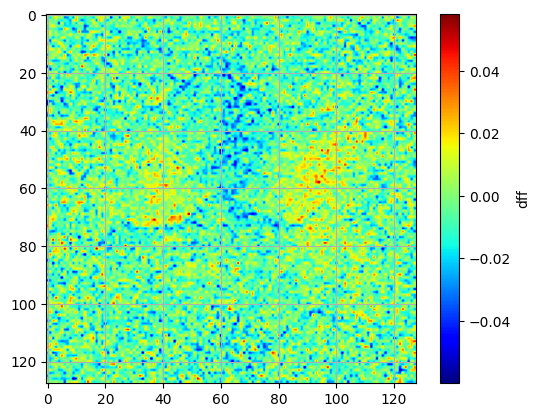

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:40,  3.13it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:36,  3.49it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:37,  3.31it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:36,  3.42it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:37,  3.31it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:36,  3.31it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:35,  3.43it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:36,  3.31it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:36,  3.22it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:35,  3.28it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:36,  3.22it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:35,  3.25it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:35,  3.26it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.24it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.28it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:35,  3.18it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:34,  3.22it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:35,  3.10it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:33,  3.25it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:32,  3.32it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:32,  3.33it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:32,  3.23it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:31,  3.29it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:32,  3.16it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:31,  3.26it/s]

 20%|████████████████▍                                                                | 26/128 [00:07<00:30,  3.33it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:30,  3.29it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:29,  3.43it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:28,  3.50it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:27,  3.55it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:28,  3.44it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:30,  3.15it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:28,  3.33it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:27,  3.40it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:28,  3.26it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:28,  3.21it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:28,  3.17it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:28,  3.14it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:27,  3.20it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:28,  3.04it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:29,  2.95it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:28,  3.00it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:27,  3.05it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:26,  3.14it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:26,  3.18it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:25,  3.25it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:24,  3.34it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:24,  3.23it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:23,  3.30it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:23,  3.35it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.25it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:22,  3.31it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:22,  3.41it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:21,  3.38it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:20,  3.49it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:21,  3.33it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:21,  3.27it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:22,  3.09it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:21,  3.20it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:21,  3.23it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:20,  3.34it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.29it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.36it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:19,  3.21it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:19,  3.28it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.35it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.39it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:17,  3.37it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:17,  3.40it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:16,  3.42it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:16,  3.47it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:21<00:16,  3.30it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:16,  3.31it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.25it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:22<00:16,  3.28it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:16,  3.21it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.22it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:15,  3.23it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:15,  3.27it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:15,  3.11it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:15,  3.12it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:14,  3.17it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:14,  3.20it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:13,  3.23it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:13,  3.23it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:13,  3.16it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:12,  3.17it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:13,  2.96it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:13,  2.89it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:12,  2.99it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:12,  3.07it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:11,  3.16it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.23it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:10,  3.31it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:09,  3.42it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:09,  3.32it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.27it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.33it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.35it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.39it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:08,  3.25it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.33it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.26it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.15it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:07,  3.26it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.26it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.25it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.33it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.43it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:33<00:05,  3.50it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:04,  3.47it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:04,  3.25it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.35it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:04,  3.30it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:04,  3.24it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.21it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:35<00:03,  3.33it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:03,  3.16it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.07it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:36<00:02,  3.06it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.21it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.33it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:37<00:01,  3.49it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.39it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.44it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.39it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:38<00:00,  3.36it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.35it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.27it/s]

frame number 200 plotted


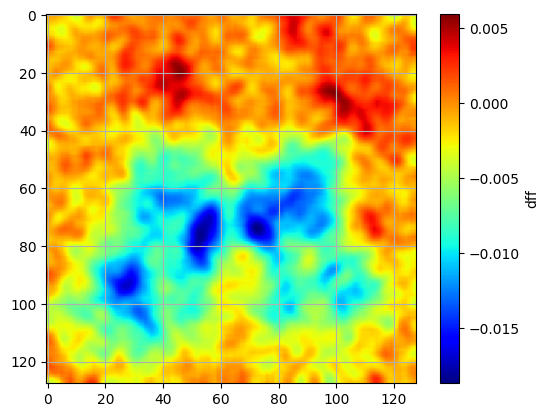

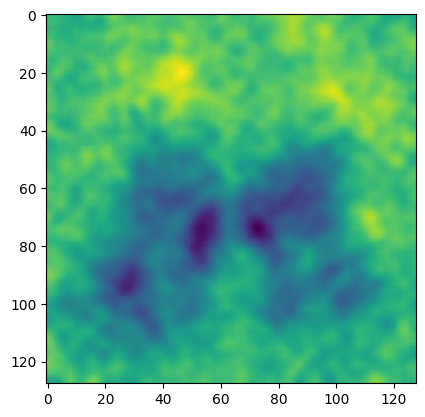

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 15


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 34
fail = 7
total trials = 41


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 35
fail = 9
total trials = 44


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 1
fail = 14
total trials = 15


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34473 [00:00<?, ?it/s]

  9%|██████▌                                                                   | 3060/34473 [00:00<00:01, 30307.38it/s]

 18%|█████████████                                                             | 6091/34473 [00:00<00:00, 29620.74it/s]

 26%|███████████████████▍                                                      | 9054/34473 [00:00<00:00, 27756.40it/s]

 34%|█████████████████████████                                                | 11841/34473 [00:00<00:00, 23857.76it/s]

 41%|██████████████████████████████▎                                          | 14292/34473 [00:00<00:00, 23546.25it/s]

 48%|███████████████████████████████████▎                                     | 16686/34473 [00:00<00:00, 23312.55it/s]

 55%|████████████████████████████████████████▎                                | 19065/34473 [00:00<00:00, 23388.30it/s]

 62%|█████████████████████████████████████████████▎                           | 21421/34473 [00:00<00:00, 22115.13it/s]

 69%|██████████████████████████████████████████████████                       | 23652/34473 [00:01<00:00, 21640.22it/s]

 75%|██████████████████████████████████████████████████████▋                  | 25829/34473 [00:01<00:00, 21373.33it/s]

 81%|███████████████████████████████████████████████████████████▏             | 27974/34473 [00:01<00:00, 21336.19it/s]

 88%|████████████████████████████████████████████████████████████████▍        | 30434/34473 [00:01<00:00, 22222.20it/s]

 96%|█████████████████████████████████████████████████████████████████████▉   | 33042/34473 [00:01<00:00, 23285.75it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34473/34473 [00:01<00:00, 23450.02it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 11768.36it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 22229.13it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")